## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'standardTesting-full' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_full_standardTesting.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/standardTesting/full/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 7077888,
 1: 7077888,
 2: 7077888,
 3: 7077888,
 4: 7077888,
 5: 7077888,
 6: 7077888,
 7: 7077888,
 8: 7077888,
 9: 7077888,
 10: 7077888,
 11: 7077888,
 12: 7077888,
 13: 7077888,
 14: 7077888,
 15: 7077888,
 16: 7077888,
 17: 7077888,
 18: 7077888,
 19: 7077888,
 20: 7077888,
 21: 7077888,
 22: 7077888,
 23: 7077888,
 24: 7077888,
 25: 7077888,
 26: 7077888,
 27: 7077888,
 28: 7077888,
 29: 7077888,
 30: 7077888,
 31: 7077888,
 32: 7077888,
 33: 7077888,
 34: 7077888,
 35: 7077888,
 36: 7077888,
 37: 7077888,
 38: 7077888,
 39: 7077888,
 40: 7077888,
 41: 7077888,
 42: 7077888,
 43: 7077888,
 44: 7077888,
 45: 7077888,
 46: 7077888,
 47: 7077888,
 48: 7077888,
 49: 7077888,
 50: 7077888,
 51: 7077888,
 52: 7077888,
 53: 7077888,
 54: 7077888,
 55: 7077888,
 56: 7077888,
 57: 7077888,
 58: 7077888,
 59: 7077888,
 60: 7077888,
 61: 7077888,
 62: 7077888,
 63: 7077888}

Running 12760 CDFs


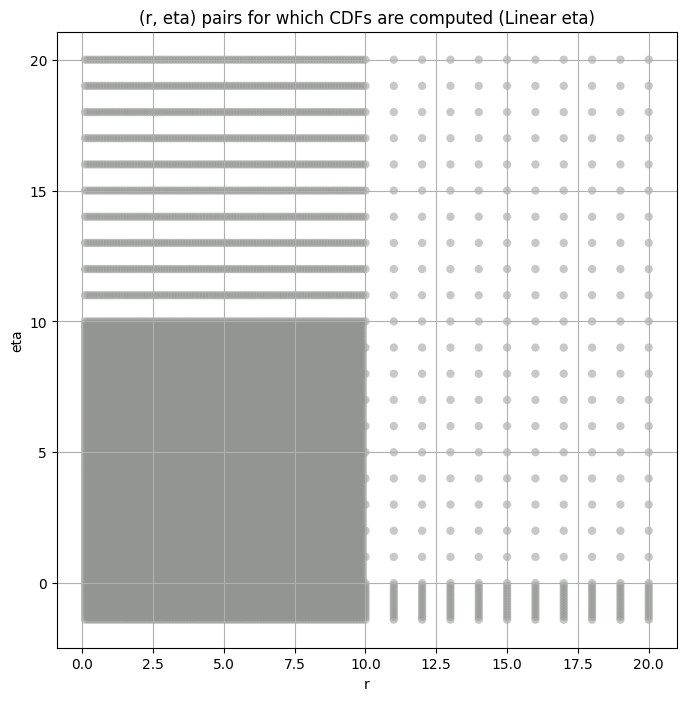

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,4.918292,3.402765,6.778471,14.087733,7.160851,34.707175,7077888.0,dual_color
2,5.834874,3.930150,8.610619,20.367862,9.880760,60.276031,7077888.0,dual_color
3,2.401070,1.665375,3.542346,21.989695,7.956547,102.828290,7077888.0,single_edge
4,8.374049,6.064171,10.875553,12.093866,7.784488,19.337828,7077888.0,dual_color
5,6.427816,4.854648,7.951692,7.636214,4.954015,14.957260,7077888.0,dual_color
6,2.961975,2.211630,3.853347,10.482830,4.624699,35.951347,7077888.0,single_edge
7,2.415839,2.004647,2.878406,2.770392,1.080253,8.056585,7077888.0,inside_out
8,0.113790,0.088581,0.153305,9.237642,2.534635,61.519856,7077888.0,misc
9,0.869234,0.549242,1.463015,30.971350,8.339682,139.176879,7077888.0,multi_edge


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,4.918292,4.918292,4.589598,4.374348,4.042061
2,5.834874,5.834874,5.334577,5.026945,4.573351
3,2.401070,2.401070,2.177716,2.057714,1.883030
4,8.374049,8.374049,7.942413,7.628345,7.110093
5,6.427816,6.427816,6.162587,5.974117,5.661917
6,2.961975,2.961975,2.785122,2.679611,2.518007
7,2.415839,2.415839,2.340554,2.291171,2.213606
8,0.113790,0.113790,0.106642,0.102843,0.097348
9,0.869234,0.869234,0.762505,0.711100,0.641902


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,4.918292,3.402765,6.778471,14.087733,7.160851,34.707175,7077888.0,dual_color,0.031126,0.1,1.0,8.494620e-15,200.0,4.042061,0.00051
2,5.834874,3.930150,8.610619,20.367862,9.880760,60.276031,7077888.0,dual_color,0.022405,0.3,-1.1,2.776016e-01,200.0,4.573351,0.00051
3,2.401070,1.665375,3.542346,21.989695,7.956547,102.828290,7077888.0,single_edge,0.006777,0.2,-0.5,1.440289e-04,50.0,2.177716,0.00051
4,8.374049,6.064171,10.875553,12.093866,7.784488,19.337828,7077888.0,dual_color,0.022677,0.4,-1.2,3.417791e+00,200.0,7.110093,0.00051
5,6.427816,4.854648,7.951692,7.636214,4.954015,14.957260,7077888.0,dual_color,0.021053,0.2,-0.3,2.037893e-04,50.0,6.162587,0.00051
6,2.961975,2.211630,3.853347,10.482830,4.624699,35.951347,7077888.0,single_edge,0.021525,0.2,-0.3,8.861147e-05,100.0,2.679611,0.00051
7,2.415839,2.004647,2.878406,2.770392,1.080253,8.056585,7077888.0,inside_out,0.020858,4.8,-0.5,4.574629e+00,200.0,2.213606,0.00051
8,0.113790,0.088581,0.153305,9.237642,2.534635,61.519856,7077888.0,misc,0.018440,0.1,9.4,2.752700e-22,200.0,0.097348,0.00051
9,0.869234,0.549242,1.463015,30.971350,8.339682,139.176879,7077888.0,multi_edge,0.004238,0.2,-0.4,3.521787e-05,50.0,0.762505,0.00051


## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 100 = 300, ksstat: 0.031197254008845987, var: 3.7791336176638612


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 75 = 275, ksstat: 0.031154006430120673, var: 3.8401749194460386


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 50 = 250, ksstat: 0.031125939243740186, var: 3.9041421568549364


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 25 = 225, ksstat: 0.031126050441899866, var: 3.971301681629851


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 0 = 200, ksstat: 0.031126029166513858, var: 4.04206121956182


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -25 = 175, ksstat: 0.031133243891784845, var: 4.116911993851674


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -50 = 150, ksstat: 0.031226257283774816, var: 4.196506710502748


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -75 = 125, ksstat: 0.031171663339260636, var: 4.28186534869814


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -100 = 100, ksstat: 0.031125881371534048, var: 4.374347887163004
Number of samples: 100000, Without approximation : 7077888.0


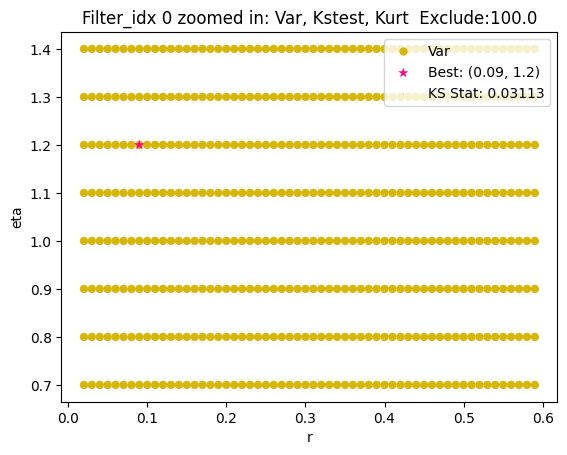

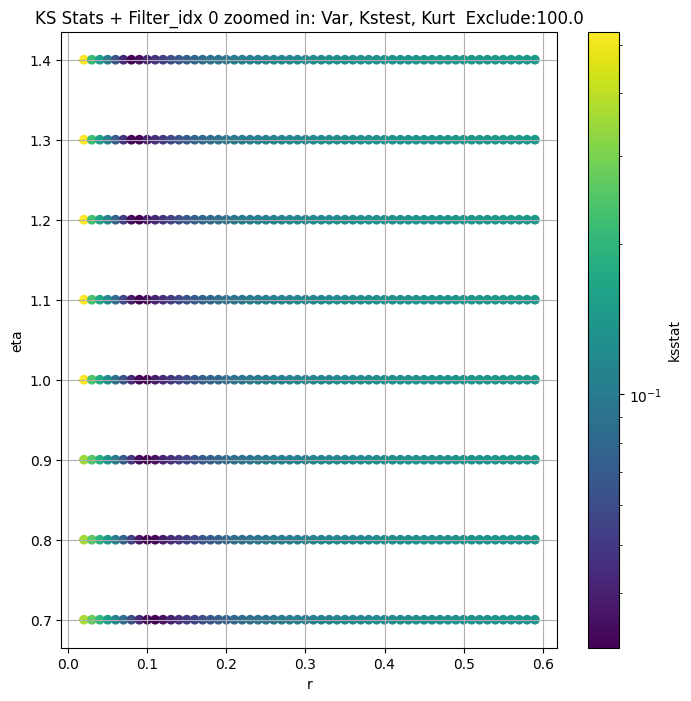

Filter_idx 2


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + 100 = 300, ksstat: 0.022389889616506065, var: 4.221433275103645


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + 75 = 275, ksstat: 0.022154438659257203, var: 4.303033879616949


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + 50 = 250, ksstat: 0.021915148142737706, var: 4.388564709026344


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + 25 = 225, ksstat: 0.021676909505573605, var: 4.478480404375538


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + 0 = 200, ksstat: 0.022405340599795598, var: 4.573351343068273


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + -25 = 175, ksstat: 0.021629424629799332, var: 4.6741971141889245


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + -50 = 150, ksstat: 0.020770528686631373, var: 4.782264909901338


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + -75 = 125, ksstat: 0.021438981307915328, var: 4.899077839632131


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 2, 200.0 + -100 = 100, ksstat: 0.021640292085916668, var: 5.026945135078442
Number of samples: 100000, Without approximation : 7077888.0


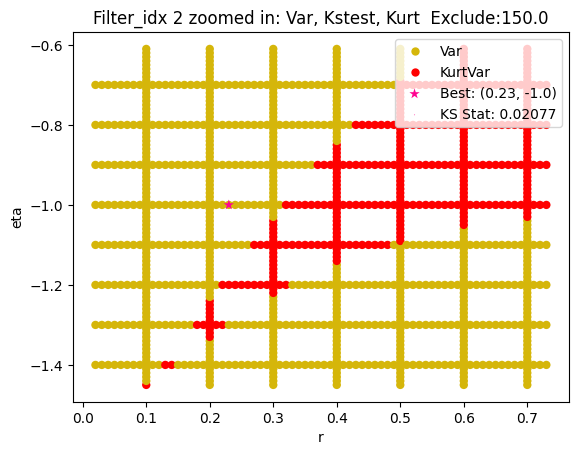

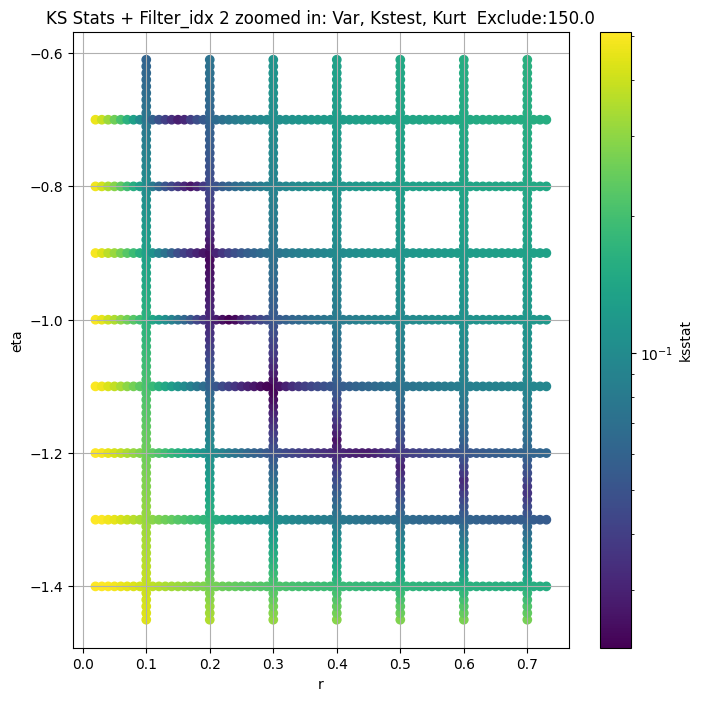

Filter_idx 3


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + 100 = 150, ksstat: 0.007906663518873147, var: 1.9630865590874835


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + 75 = 125, ksstat: 0.007687656367619991, var: 2.008134795982504


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + 50 = 100, ksstat: 0.00702082876915211, var: 2.0577143638560047


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + 25 = 75, ksstat: 0.007188213458506315, var: 2.1134066824971742


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + 0 = 50, ksstat: 0.006776521526299928, var: 2.1777163859031177


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + -25 = 25, ksstat: 0.006670442299692464, var: 2.256831146020288


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 50.0 + -50 = 0, ksstat: 0.006627526722037813, var: 2.40106956545116
Number of samples: 100000, Without approximation : 7077888.0


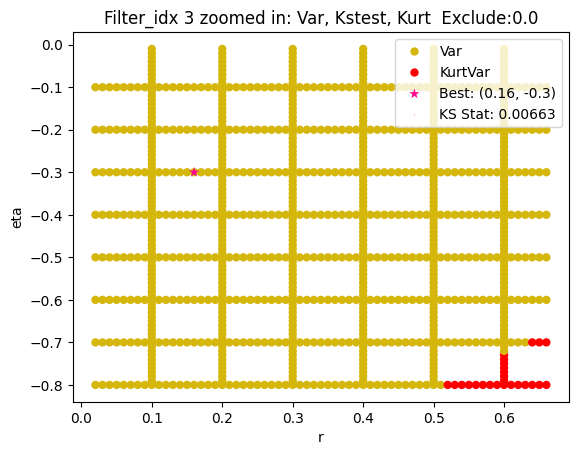

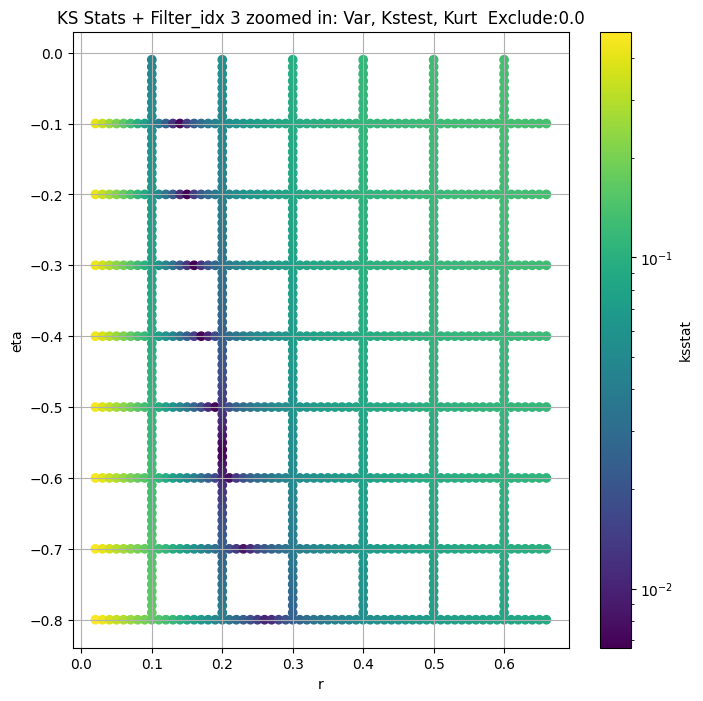

Filter_idx 4


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + 100 = 300, ksstat: 0.02252188479249362, var: 6.67067133326533


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + 75 = 275, ksstat: 0.02238383926258619, var: 6.774685757208923


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + 50 = 250, ksstat: 0.02278509467497436, var: 6.882446813687129


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + 25 = 225, ksstat: 0.022825199605057356, var: 6.994111217682925


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + 0 = 200, ksstat: 0.02267735405814897, var: 7.110093254316673


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + -25 = 175, ksstat: 0.022526515716711715, var: 7.230706752052767


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + -50 = 150, ksstat: 0.022875908230152064, var: 7.356500563658176


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + -75 = 125, ksstat: 0.022199163523660914, var: 7.488519719023832


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 4, 200.0 + -100 = 100, ksstat: 0.022412681330199913, var: 7.628345165109805
Number of samples: 100000, Without approximation : 7077888.0


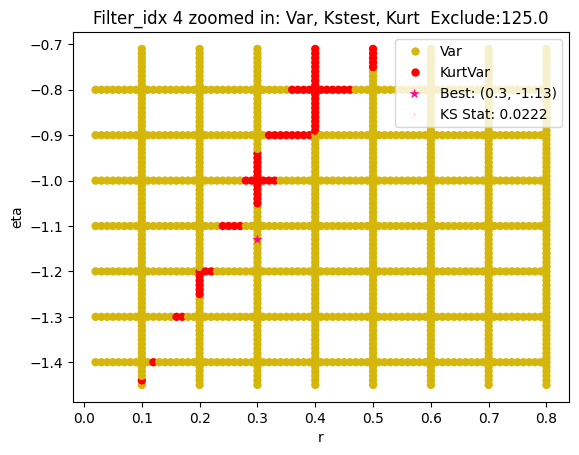

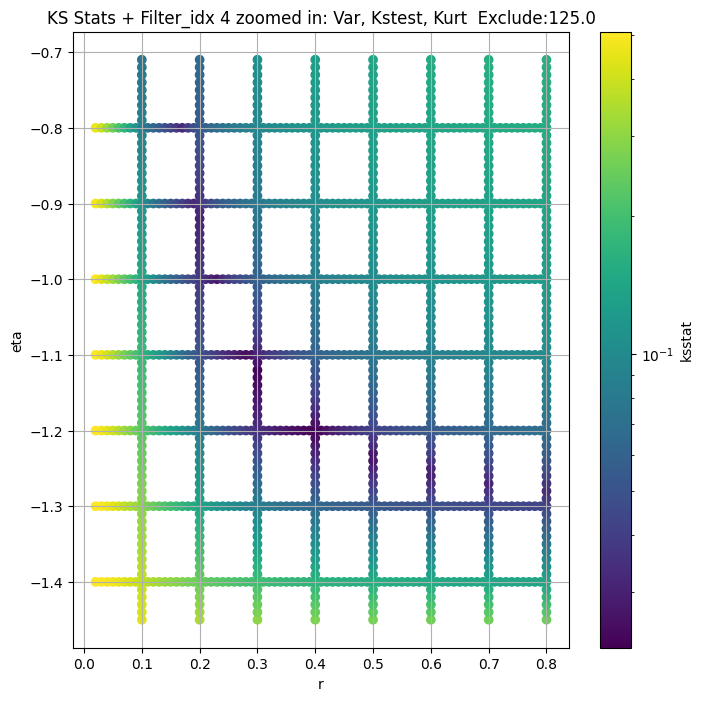

Filter_idx 5


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + 100 = 150, ksstat: 0.020949125928954926, var: 5.8101479352476195


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + 75 = 125, ksstat: 0.021017520307894166, var: 5.8898365704641495


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + 50 = 100, ksstat: 0.021086923064465024, var: 5.974116845735123


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + 25 = 75, ksstat: 0.021051126786936436, var: 6.064149301107906


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + 0 = 50, ksstat: 0.020786079405945235, var: 6.162587109190497


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + -25 = 25, ksstat: 0.020839086400628926, var: 6.274833142745433


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 5, 50.0 + -50 = 0, ksstat: 0.02109182492773115, var: 6.427816350520922
Number of samples: 100000, Without approximation : 7077888.0


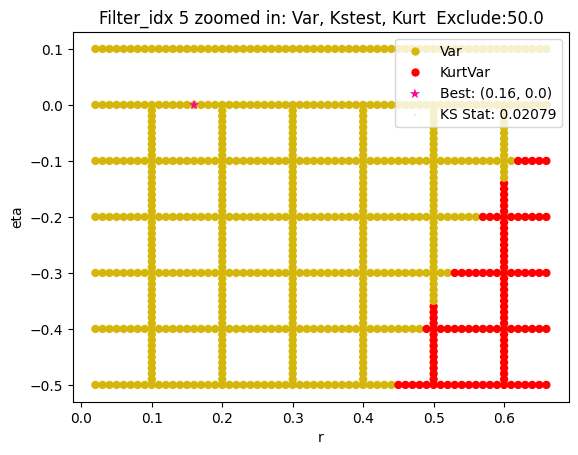

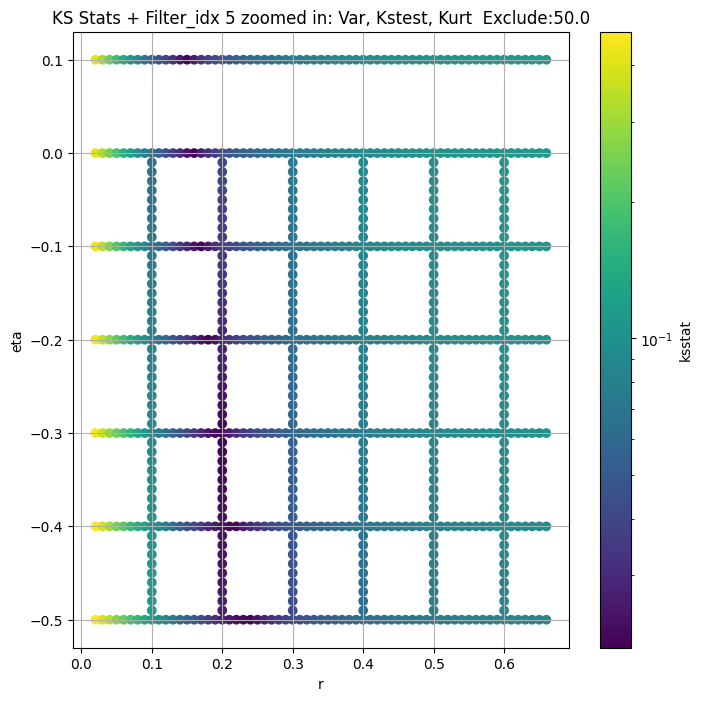

Filter_idx 6


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + 100 = 200, ksstat: 0.021526212836111946, var: 2.518007140812964


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + 75 = 175, ksstat: 0.02152430813488243, var: 2.5544301147420145


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + 50 = 150, ksstat: 0.02152393717903378, var: 2.593195123012023


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + 25 = 125, ksstat: 0.02152385890804348, var: 2.634689108008197


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + 0 = 100, ksstat: 0.02152425700278049, var: 2.6796109993558774


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + -25 = 75, ksstat: 0.02152335941075867, var: 2.729074264579624


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + -50 = 50, ksstat: 0.021523811745365218, var: 2.7851215610497206


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + -75 = 25, ksstat: 0.021524554390794037, var: 2.852297592498641


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 6, 100.0 + -100 = 0, ksstat: 0.021523428526291633, var: 2.961974639804508
Number of samples: 100000, Without approximation : 7077888.0


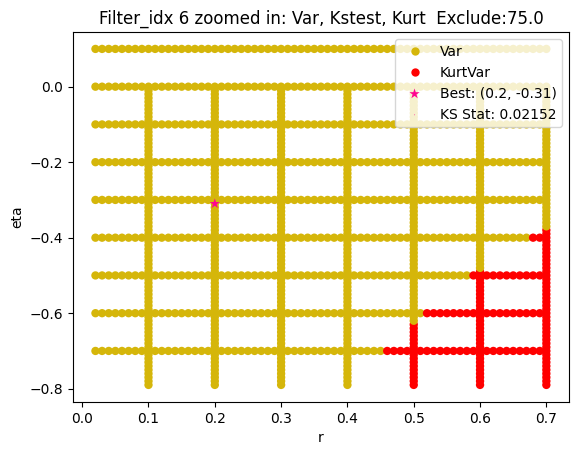

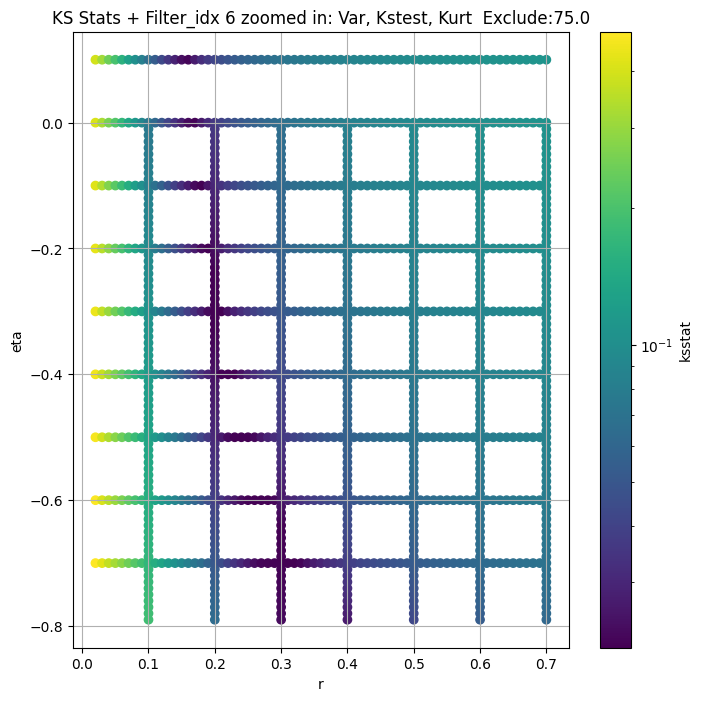

Filter_idx 7


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + 100 = 300, ksstat: 0.020881775273428715, var: 2.150516134747821


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + 75 = 275, ksstat: 0.020955143197202264, var: 2.165323619366235


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + 50 = 250, ksstat: 0.021027619204306847, var: 2.1807251452945526


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + 25 = 225, ksstat: 0.020993172676403105, var: 2.196795531212174


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + 0 = 200, ksstat: 0.02085819481215223, var: 2.2136063401951844


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + -25 = 175, ksstat: 0.02088876775945181, var: 2.2312454108526985


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + -50 = 150, ksstat: 0.020846789929118037, var: 2.2499124239116624


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + -75 = 125, ksstat: 0.02088418053435781, var: 2.269794443390746


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 7, 200.0 + -100 = 100, ksstat: 0.02090626575391996, var: 2.291171175908124
Number of samples: 100000, Without approximation : 7077888.0


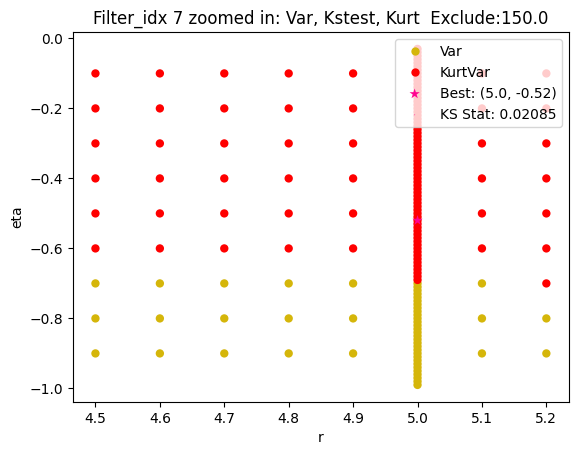

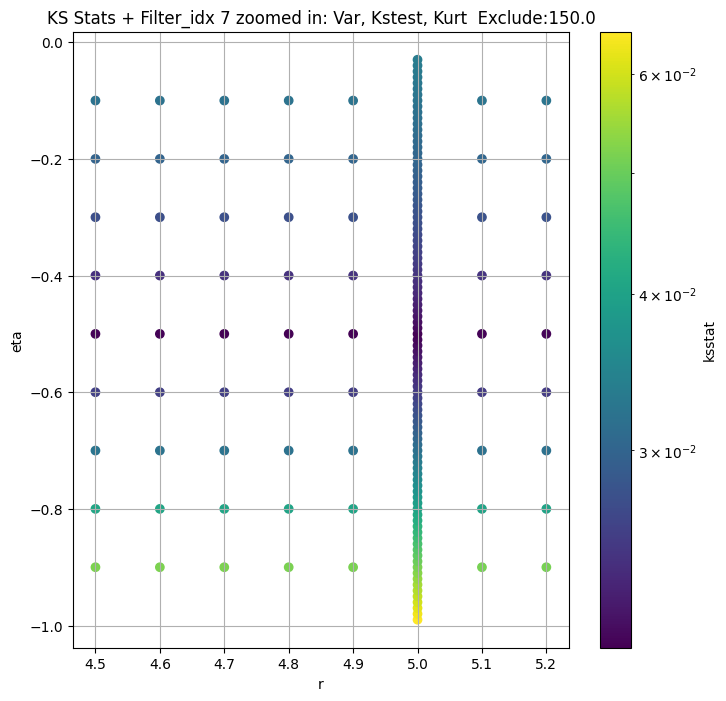

Filter_idx 8


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.01855587696570493, var: 0.09320348785528207


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.018508020440793582, var: 0.09415405212781514


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.01849839583098145, var: 0.09515615452417911


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.018475915906198015, var: 0.09621764116480072


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.018440474029940757, var: 0.09734779350763607


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.018439101618139497, var: 0.09855864325205871


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.018518386707742085, var: 0.09986388529821036


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.018782313702227937, var: 0.10127838375595953


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.01856272859213126, var: 0.10284258480140658
Number of samples: 100000, Without approximation : 7077888.0


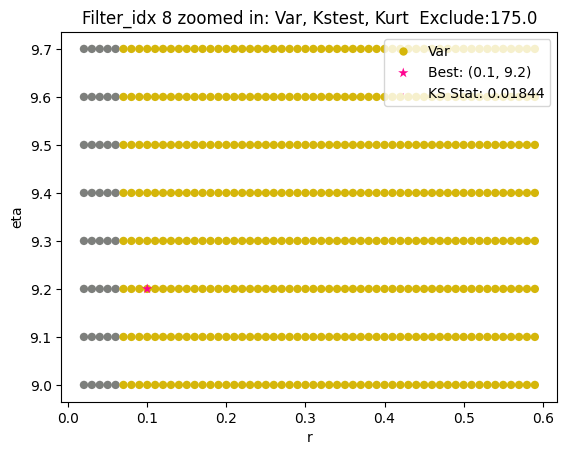

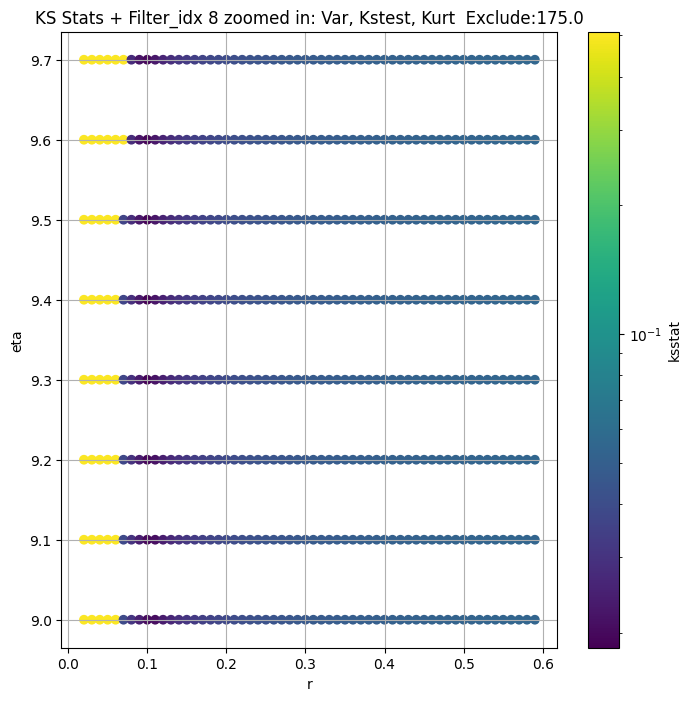

Filter_idx 9


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + 100 = 150, ksstat: 0.003980015726166217, var: 0.6728851363387333


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + 75 = 125, ksstat: 0.003550391303764406, var: 0.6909200821028997


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + 50 = 100, ksstat: 0.003093899682436785, var: 0.7111004295140181


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + 25 = 75, ksstat: 0.002627863136616143, var: 0.73432378751805


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + 0 = 50, ksstat: 0.0022225988688767823, var: 0.7625054120143552


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + -25 = 25, ksstat: 0.0029272264624911892, var: 0.7990072139492854


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 9, 50.0 + -50 = 0, ksstat: 0.0020410159577042564, var: 0.8692336019763194
Number of samples: 100000, Without approximation : 7077888.0


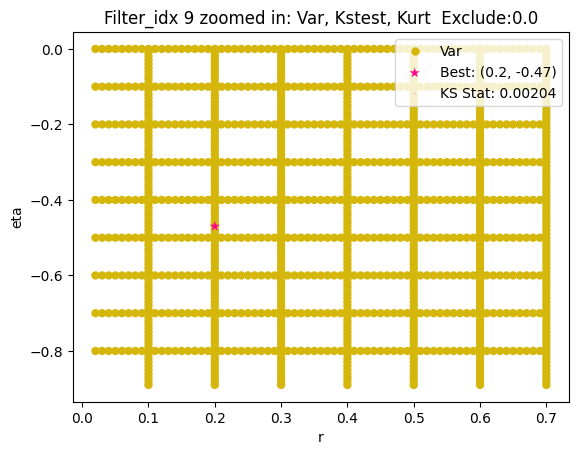

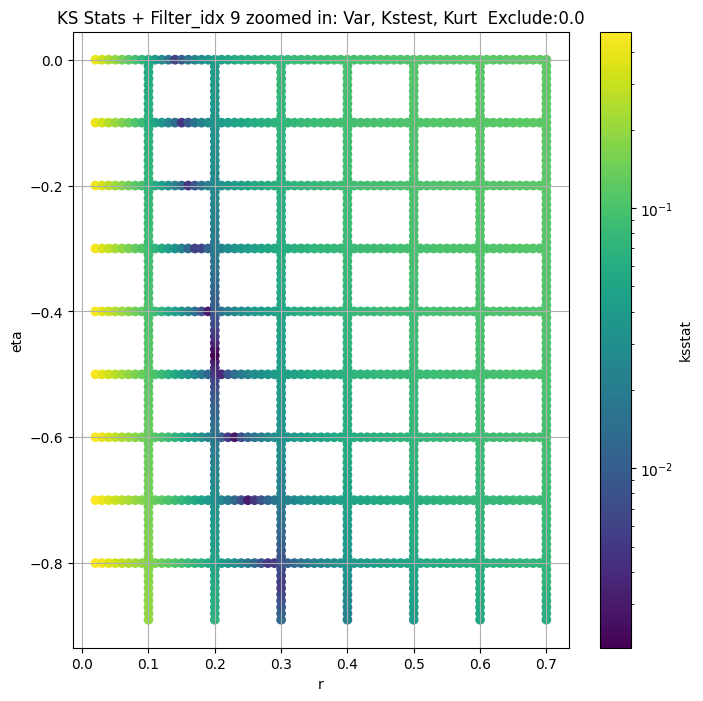

Filter_idx 10


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + 100 = 300, ksstat: 0.016527338119084134, var: 2.0923939442836006


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + 75 = 275, ksstat: 0.016528199586158476, var: 2.1220951421934036


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + 50 = 250, ksstat: 0.01652654576033208, var: 2.153203792651314


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + 25 = 225, ksstat: 0.01652677037463013, var: 2.185952483147659


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + 0 = 200, ksstat: 0.016527993880808722, var: 2.2205351651205714


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + -25 = 175, ksstat: 0.016527482820463568, var: 2.2572761705133746


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + -50 = 150, ksstat: 0.016526426159947483, var: 2.2966584716355394


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + -75 = 125, ksstat: 0.016526234756984337, var: 2.339254062743554


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 10, 200.0 + -100 = 100, ksstat: 0.016527200417916443, var: 2.3857531396361247
Number of samples: 100000, Without approximation : 7077888.0


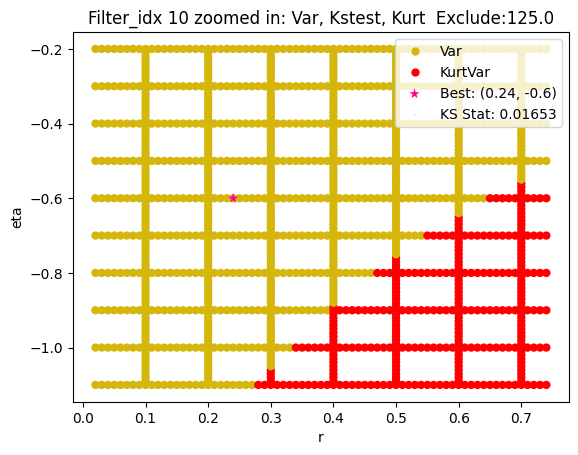

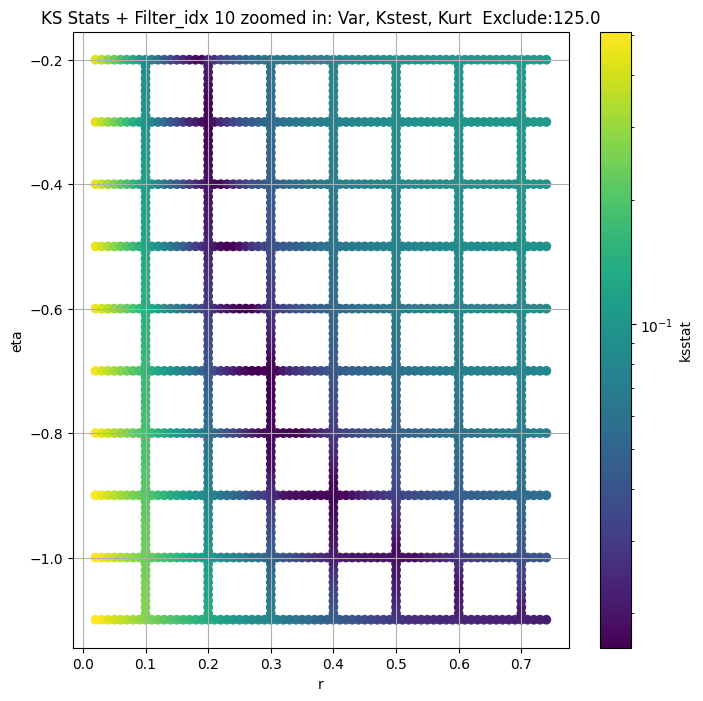

Filter_idx 11


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + 100 = 300, ksstat: 0.01627069585329427, var: 2.0496771231687485


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + 75 = 275, ksstat: 0.016551695489957996, var: 2.0805795961099642


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + 50 = 250, ksstat: 0.016512087390850874, var: 2.113019314849307


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + 25 = 225, ksstat: 0.015928711347311497, var: 2.147175935874209


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + 0 = 200, ksstat: 0.016061934471050643, var: 2.183301256281262


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + -25 = 175, ksstat: 0.015846662314188187, var: 2.2217053740638573


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + -50 = 150, ksstat: 0.015744269330743133, var: 2.2628126276812095


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + -75 = 125, ksstat: 0.015784275617783394, var: 2.3072024722965465


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 11, 200.0 + -100 = 100, ksstat: 0.015869335399573303, var: 2.3556422057369937
Number of samples: 100000, Without approximation : 7077888.0


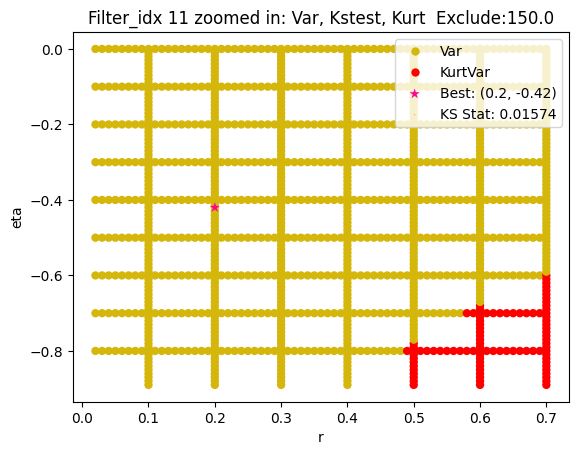

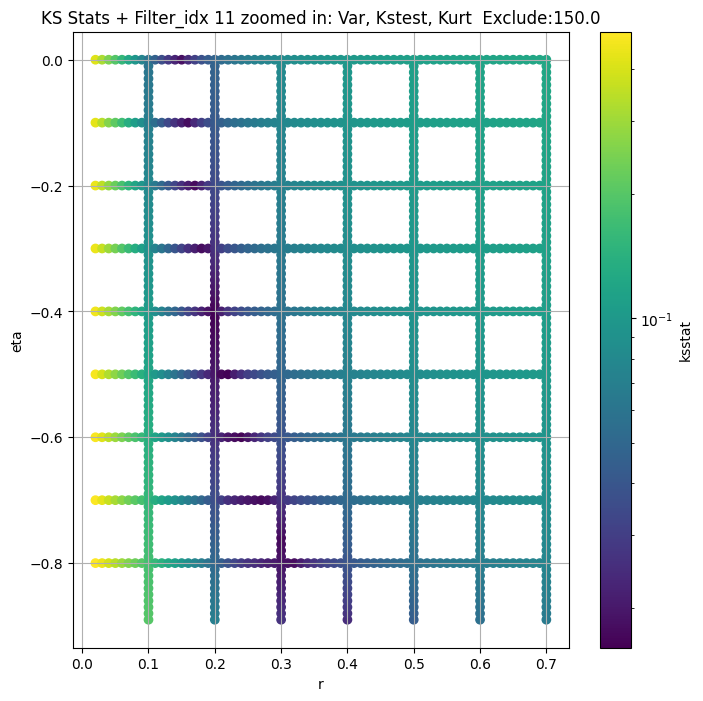

Filter_idx 12


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + 100 = 150, ksstat: 0.015152848602387803, var: 1.8105960674073107


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + 75 = 125, ksstat: 0.015117868070072482, var: 1.8479091688268876


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + 50 = 100, ksstat: 0.01518619672524818, var: 1.8889461431791972


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + 25 = 75, ksstat: 0.01519937762773338, var: 1.9349605408394597


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + 0 = 50, ksstat: 0.015149758681084147, var: 1.9882851941160757


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + -25 = 25, ksstat: 0.015249592806137913, var: 2.054078372161511


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 50.0 + -50 = 0, ksstat: 0.015207454721566871, var: 2.1701547744110403
Number of samples: 100000, Without approximation : 7077888.0


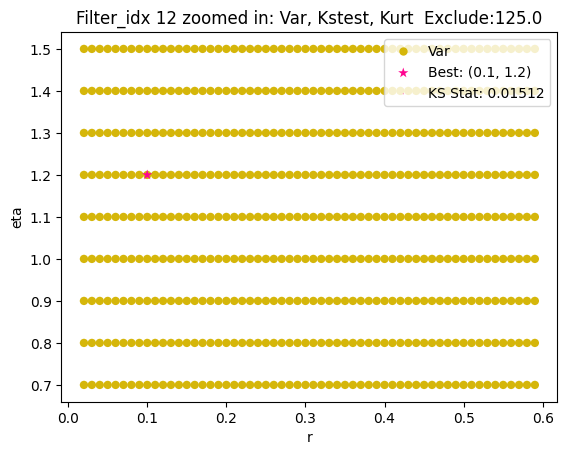

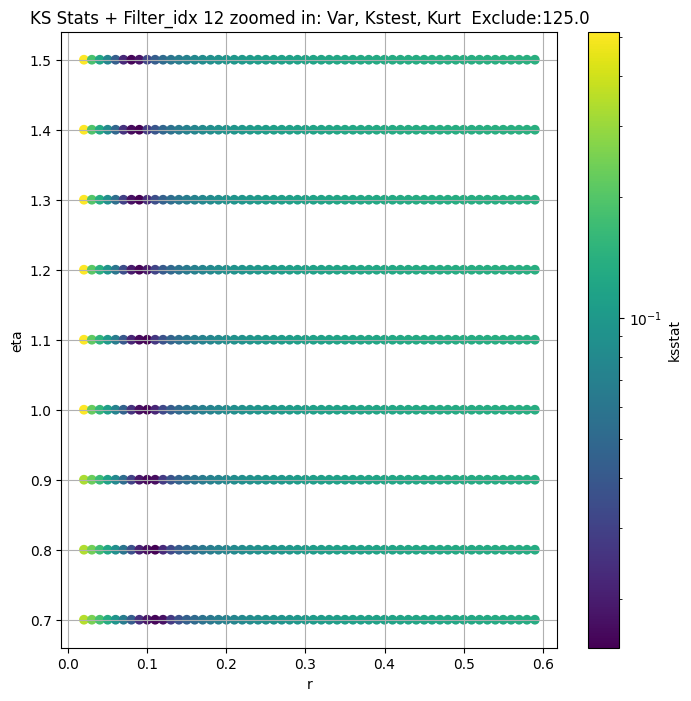

Filter_idx 13


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.013791929800144098, var: 2.2650332887922113


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.013258945377169207, var: 2.3194993945161926


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.013304368079934514, var: 2.3823663820999377


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.013206870319041775, var: 2.4590754575240212


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.01320690817924014, var: 2.5815285196307736
Number of samples: 100000, Without approximation : 7077888.0


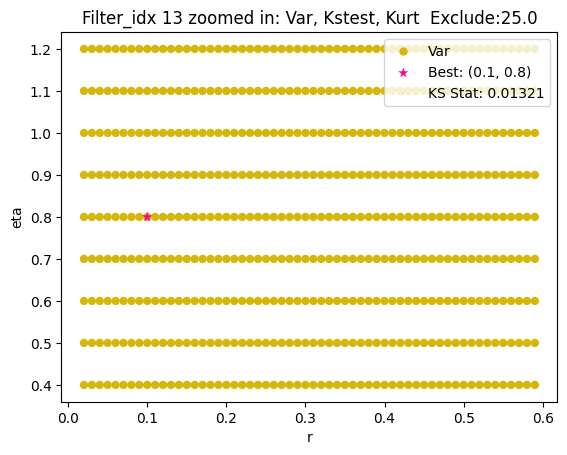

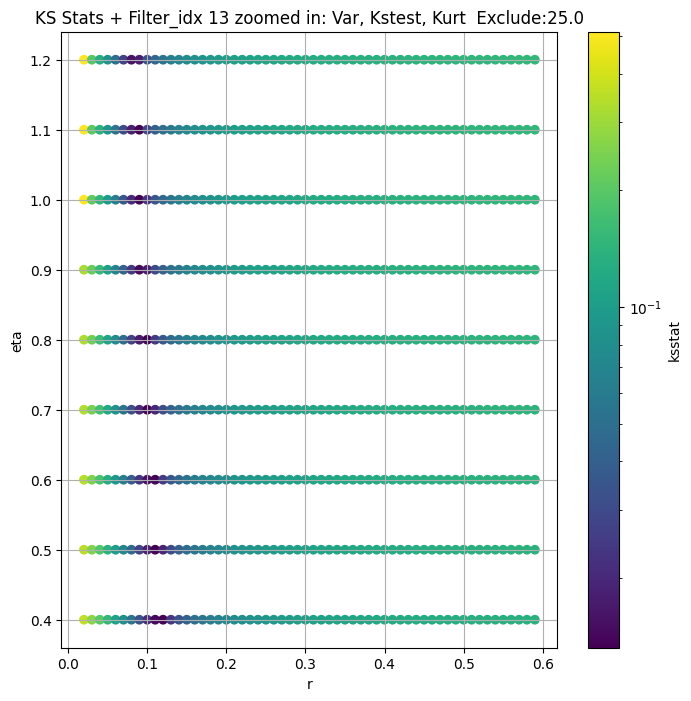

Filter_idx 14


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + 100 = 150, ksstat: 0.01123557995187479, var: 2.701541196931958


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + 75 = 125, ksstat: 0.011728828158961702, var: 2.7567668092458053


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + 50 = 100, ksstat: 0.011393370610538064, var: 2.817096129334549


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + 25 = 75, ksstat: 0.011713742941991678, var: 2.8838533255963483


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + 0 = 50, ksstat: 0.010928569457754889, var: 2.96029714383796


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + -25 = 25, ksstat: 0.010394384243084753, var: 3.0538816902539034


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 14, 50.0 + -50 = 0, ksstat: 0.010189407733511735, var: 3.2074910990243555
Number of samples: 100000, Without approximation : 7077888.0


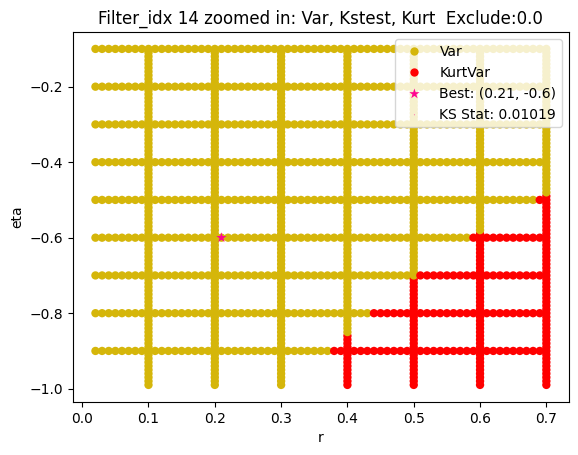

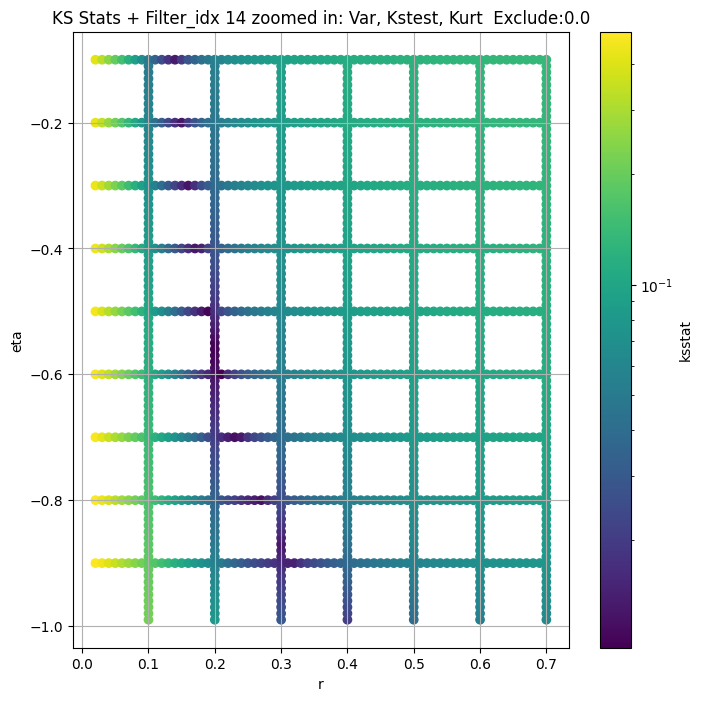

Filter_idx 15


  0%|          | 0/1008 [00:00<?, ?it/s]

Finding Minimum after computing 1008 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.015865322289927236, var: 4.52613705621741


  0%|          | 0/1008 [00:00<?, ?it/s]

Finding Minimum after computing 1008 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.015276605333208237, var: 4.556594001537851


  0%|          | 0/1008 [00:00<?, ?it/s]

Finding Minimum after computing 1008 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.014890713776735828, var: 4.5902479900920445


  0%|          | 0/1008 [00:00<?, ?it/s]

Finding Minimum after computing 1008 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.014733983763118144, var: 4.6296046725813715


  0%|          | 0/1008 [00:00<?, ?it/s]

Finding Minimum after computing 1008 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.014516856274953527, var: 4.690050154950764
Number of samples: 100000, Without approximation : 7077888.0


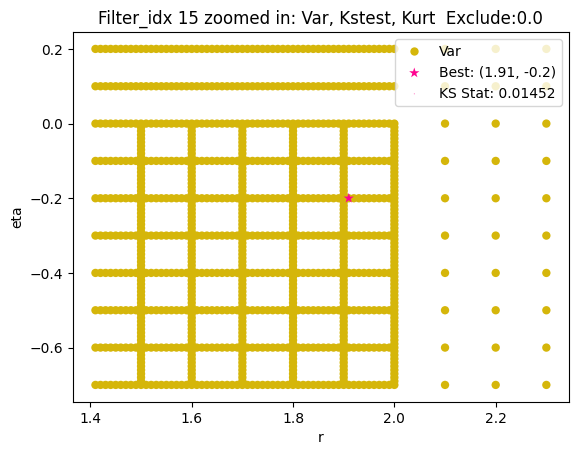

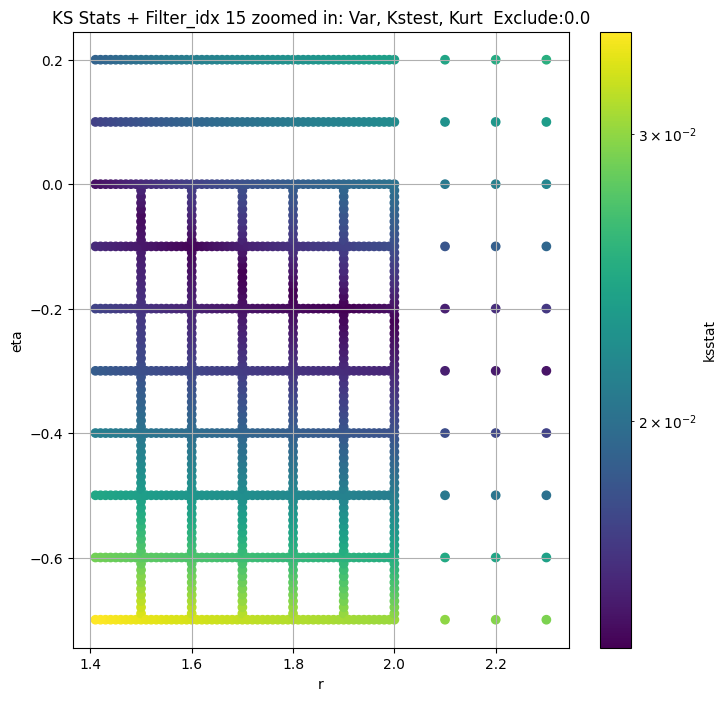

Filter_idx 16


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 100 = 300, ksstat: 0.012517503256721602, var: 1.473818334647446


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 75 = 275, ksstat: 0.012026570381899249, var: 1.4981608625211738


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 50 = 250, ksstat: 0.012007921475361782, var: 1.5238450930035463


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 25 = 225, ksstat: 0.012008193126299527, var: 1.5510546080796332


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 0 = 200, ksstat: 0.012037686521423063, var: 1.5800407865685915


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -25 = 175, ksstat: 0.012024702520940456, var: 1.61102846850515


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -50 = 150, ksstat: 0.01201931510951415, var: 1.6444007022641738


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -75 = 125, ksstat: 0.012078478806053117, var: 1.6807369629114797


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -100 = 100, ksstat: 0.012044916181364218, var: 1.7208701760691778
Number of samples: 100000, Without approximation : 7077888.0


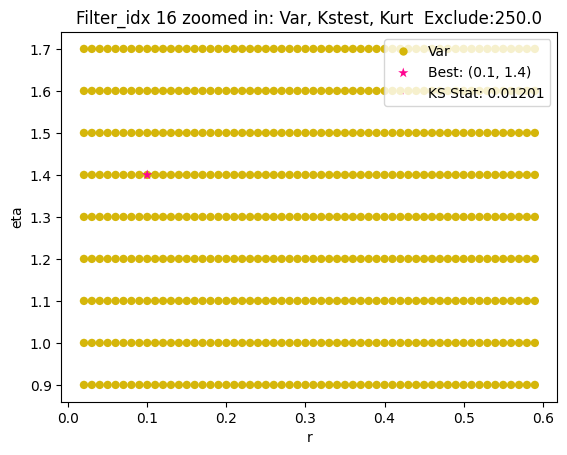

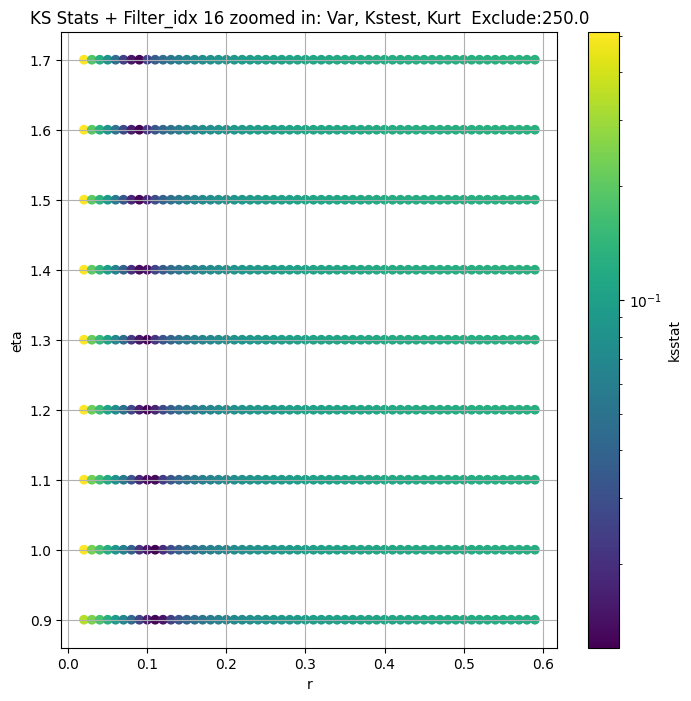

Filter_idx 17


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + 100 = 150, ksstat: 0.012902704854556302, var: 4.013595322107214


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + 75 = 125, ksstat: 0.013615485482550704, var: 4.092668424167349


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + 50 = 100, ksstat: 0.013339576197598624, var: 4.178767900342248


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + 25 = 75, ksstat: 0.013200598543583408, var: 4.27384613212063


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + 0 = 50, ksstat: 0.013411627685641525, var: 4.381768123536099


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + -25 = 25, ksstat: 0.012862369732765666, var: 4.5098094055544475


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 50.0 + -50 = 0, ksstat: 0.011937665368349837, var: 4.690126588292814
Number of samples: 100000, Without approximation : 7077888.0


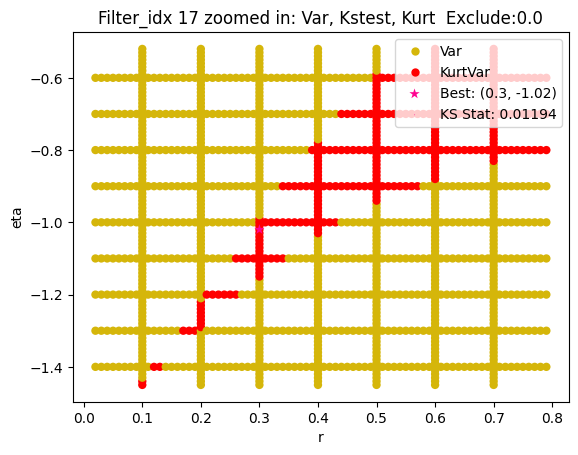

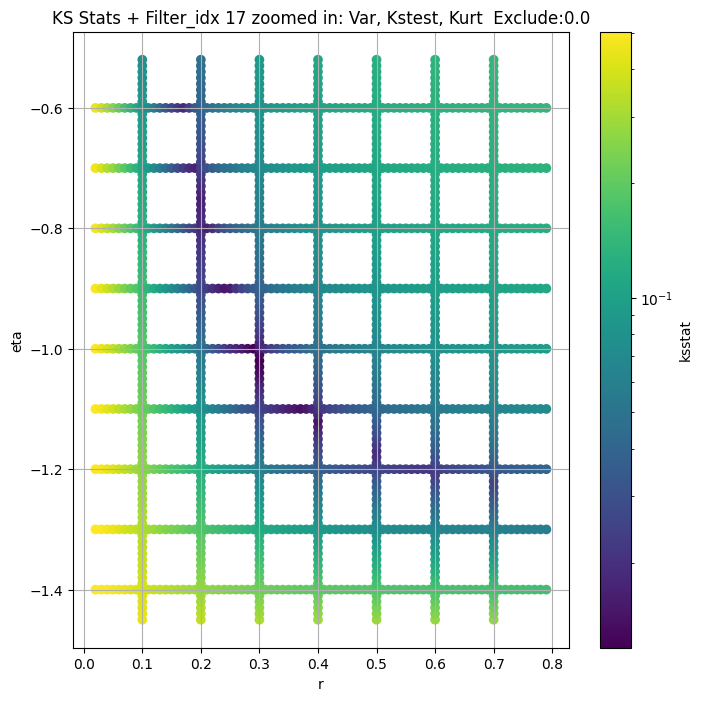

Filter_idx 18


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.00823116096745536, var: 1.358785223903035


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.008355832718371592, var: 1.388151340795079


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.00774901836264983, var: 1.4205775632627147


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.007837157822035923, var: 1.4571127237401773


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.007378182026405361, var: 1.4996621610814709


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.007495165181443858, var: 1.5528295731572954


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.007445712534481008, var: 1.648843657742327
Number of samples: 100000, Without approximation : 7077888.0


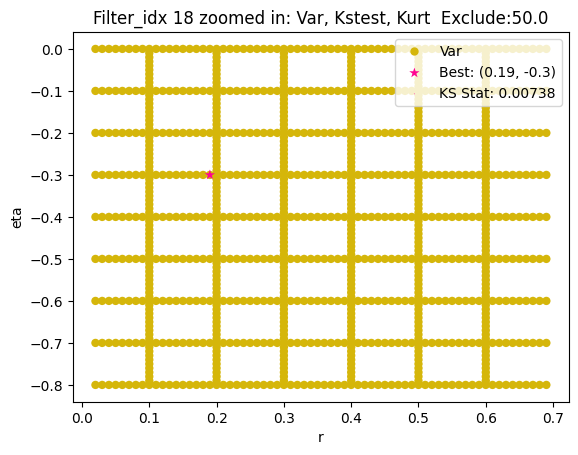

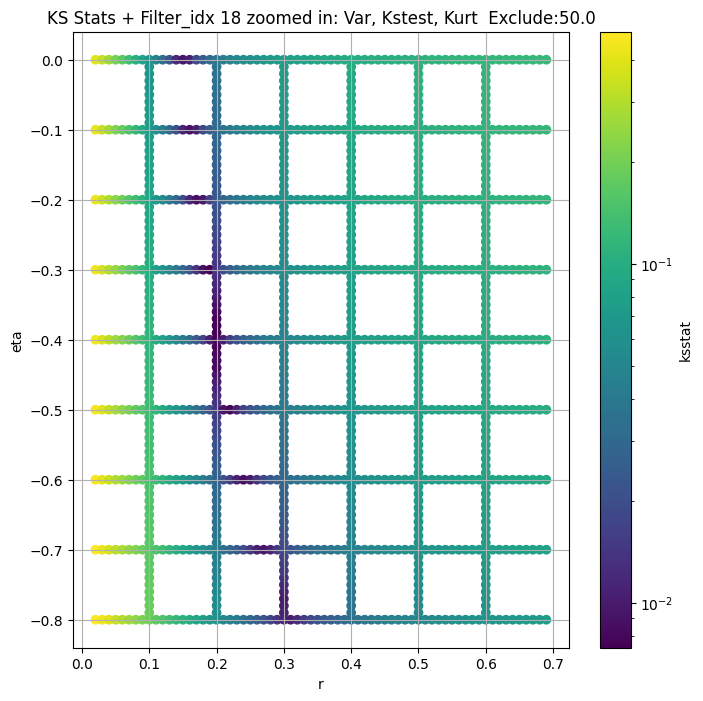

Filter_idx 20


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.009124000488195394, var: 3.866629498064263


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.008744884840575617, var: 3.9660823592327383


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.00832797288384618, var: 4.077454441270728


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.009450137647641244, var: 4.206496084845845


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.008760932128218824, var: 4.384413184870741
Number of samples: 100000, Without approximation : 7077888.0


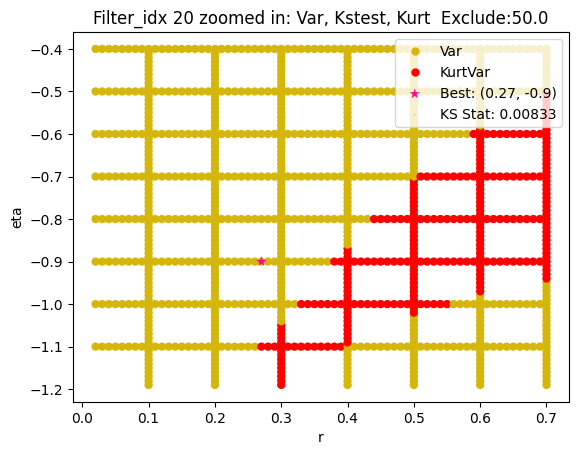

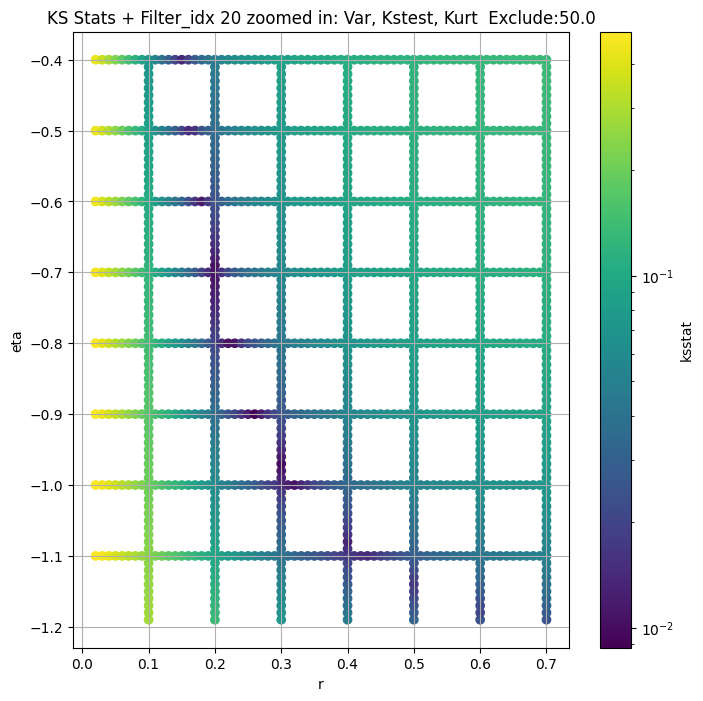

Filter_idx 22


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.012266117837838542, var: 1.8695588318952192


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.012283076093553558, var: 1.9180861208829472


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.012260884325333232, var: 1.974156740188566


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.012247093135772102, var: 2.043629372494136


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.012246630331872455, var: 2.1636653190460162
Number of samples: 100000, Without approximation : 7077888.0


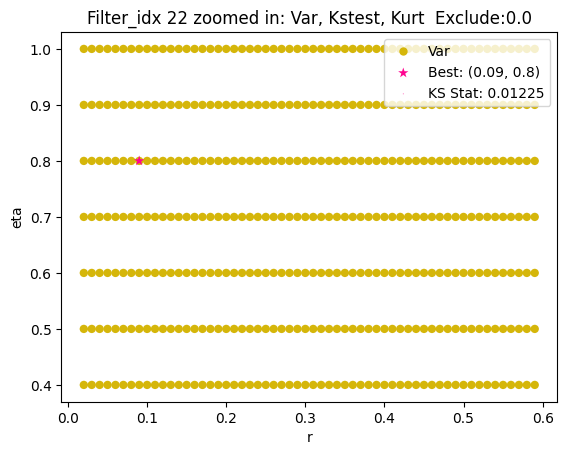

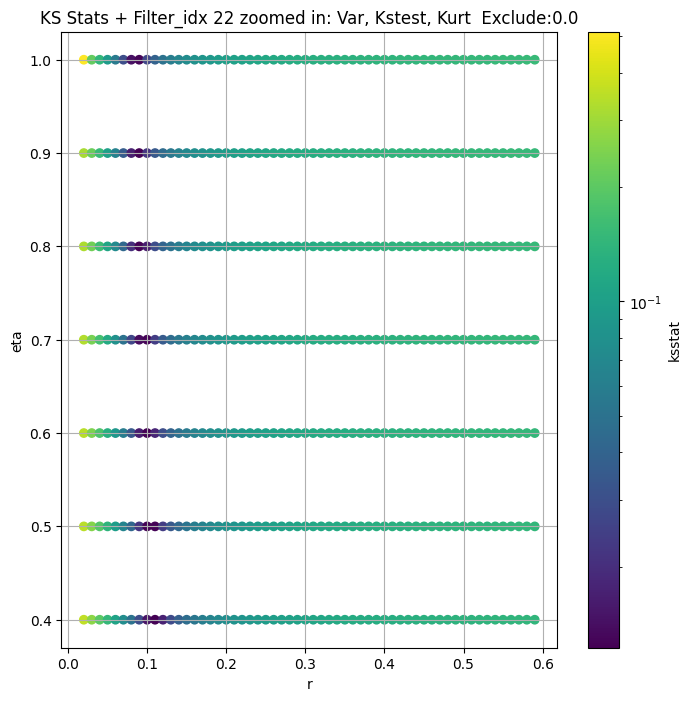

Filter_idx 23


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.010493085181803898, var: 2.6393808365844573


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.010709547584083268, var: 2.688389239640207


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.010228617037032817, var: 2.7438706471700076


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.010706582128039446, var: 2.8101802374628906


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.009801167650872383, var: 2.921042902680178
Number of samples: 100000, Without approximation : 7077888.0


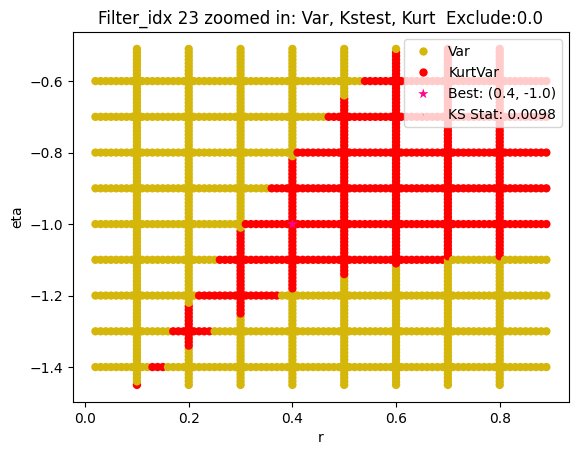

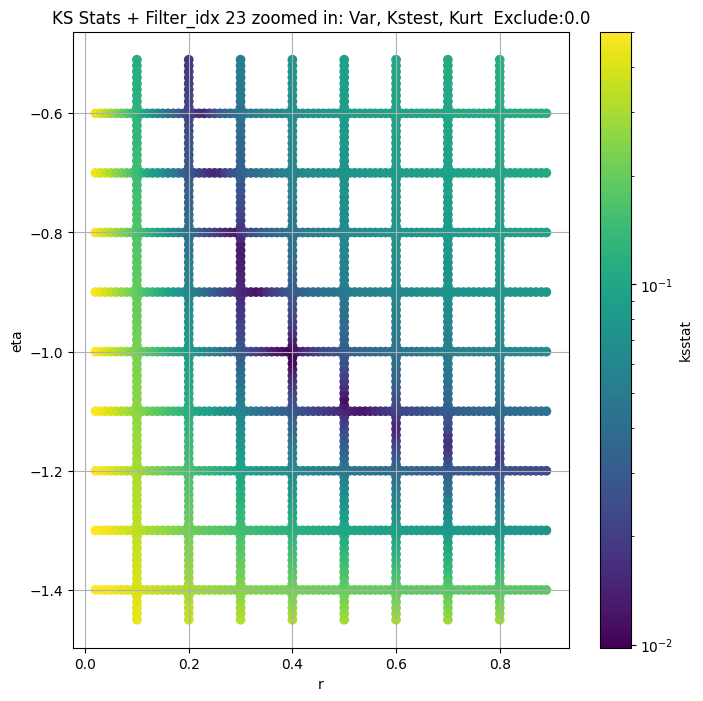

Filter_idx 24


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.01301673924806164, var: 1.885830512129714


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.012685171717387422, var: 1.9356192843679536


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.012554479097578397, var: 1.994014861861654


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.012196157248966999, var: 2.066749236046168


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.012436875992275664, var: 2.193668801936696
Number of samples: 100000, Without approximation : 7077888.0


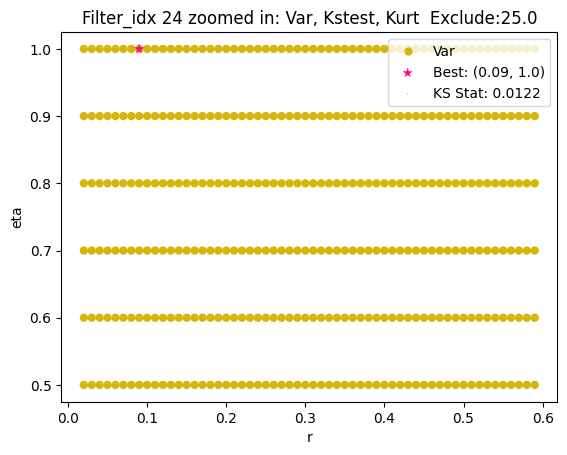

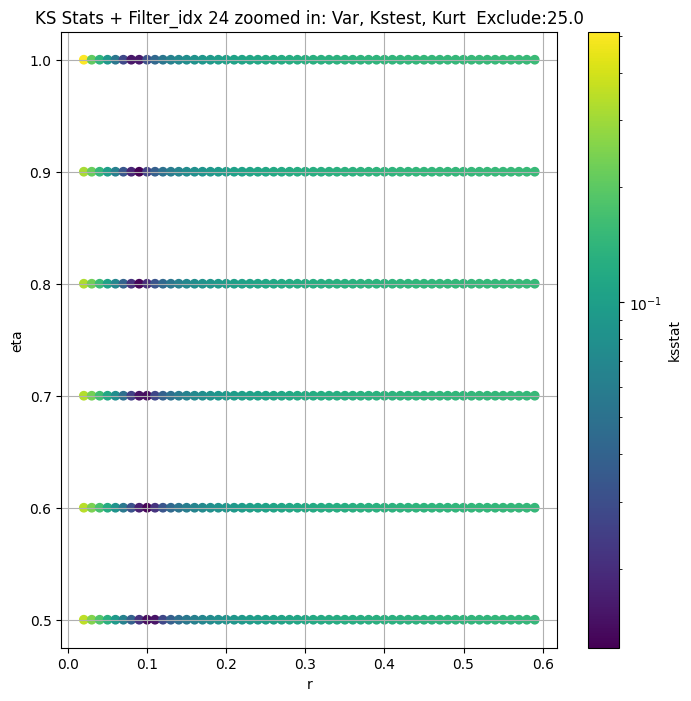

Filter_idx 25


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.0058932962702604175, var: 0.8263804092913515


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.005391289137206656, var: 0.8454306691787395


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.005303131390710258, var: 0.8663073896215545


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.0051644059740804105, var: 0.8899633346276895


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.004651759820566592, var: 0.9176474837853891


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.004324126256667116, var: 0.9526923300156102


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.004324356384832695, var: 1.0234439707238887
Number of samples: 100000, Without approximation : 7077888.0


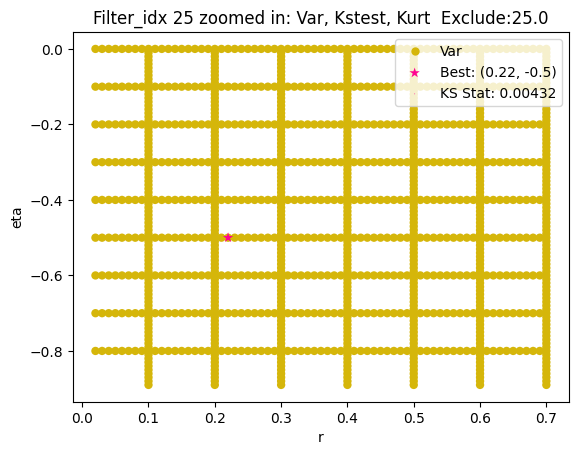

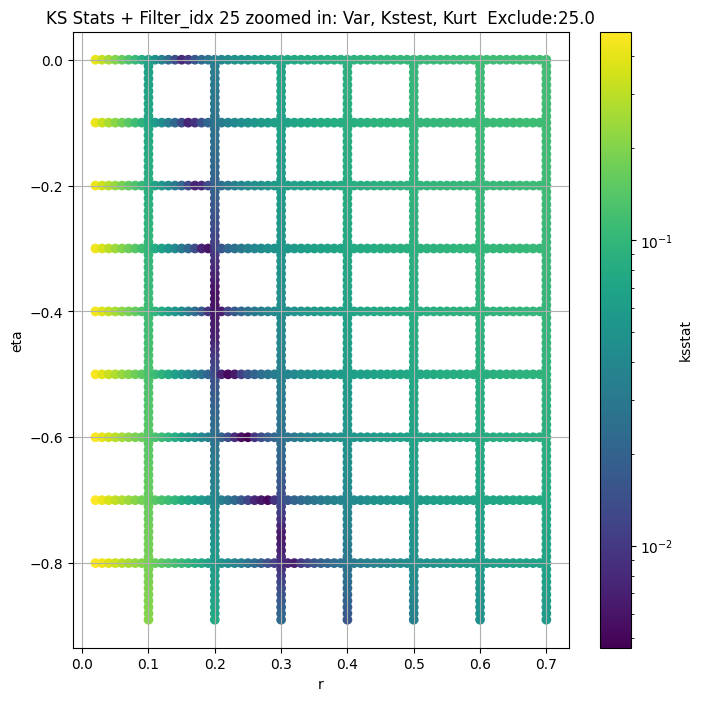

Filter_idx 26


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + 100 = 150, ksstat: 0.02145938213276888, var: 3.06491231093618


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + 75 = 125, ksstat: 0.02157279960886682, var: 3.1084503809966972


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + 50 = 100, ksstat: 0.021492446900560735, var: 3.155457720474008


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + 25 = 75, ksstat: 0.02141532412154734, var: 3.206979735483097


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + 0 = 50, ksstat: 0.021500344918873315, var: 3.2647088525749046


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + -25 = 25, ksstat: 0.021516868958373903, var: 3.332772785709942


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 50.0 + -50 = 0, ksstat: 0.021648202765494062, var: 3.4392316190612955
Number of samples: 100000, Without approximation : 7077888.0


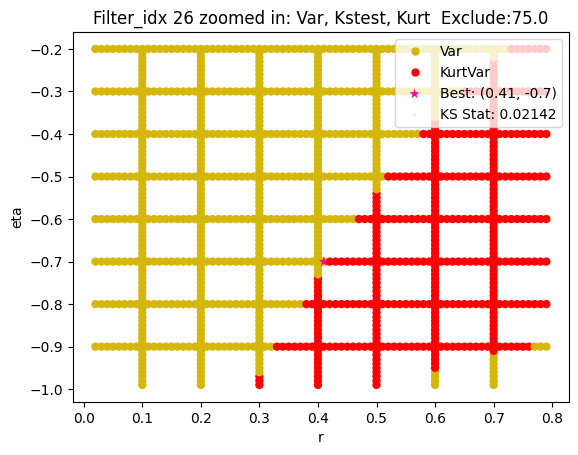

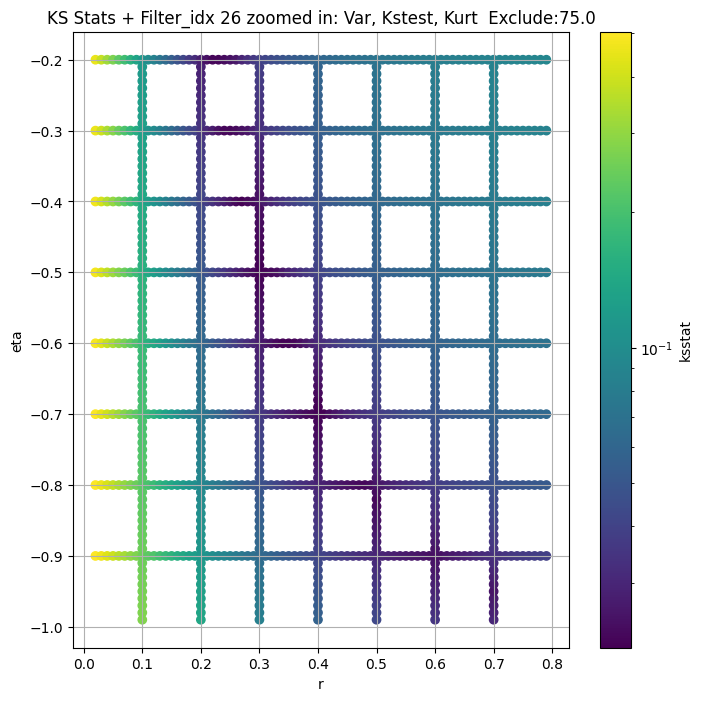

Filter_idx 27


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 27, 0.0 + 100 = 100, ksstat: 0.005421821903011749, var: 0.8588850177485082


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 27, 0.0 + 75 = 75, ksstat: 0.004727393342087147, var: 0.8855549275215614


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 27, 0.0 + 50 = 50, ksstat: 0.004518139712766753, var: 0.9171273442240115


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 27, 0.0 + 25 = 25, ksstat: 0.004156277231791128, var: 0.956939858410798


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 27, 0.0 + 0 = 0, ksstat: 0.0038753825906054917, var: 1.0269105477230835
Number of samples: 100000, Without approximation : 7077888.0


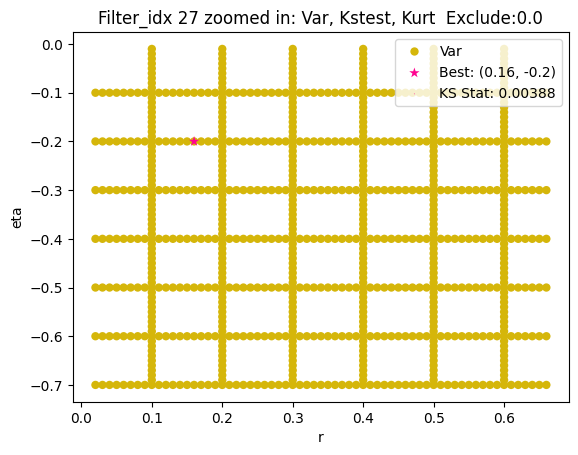

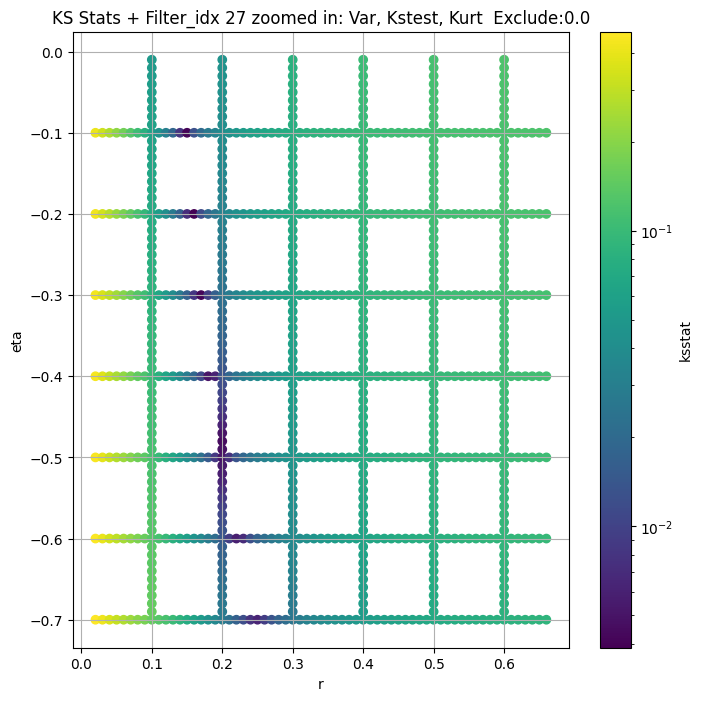

Filter_idx 28


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.014017772640278994, var: 2.179361506352034


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.013642220308616393, var: 2.2358456713415764


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.013642120103818267, var: 2.3019755275799025


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.01364263182460429, var: 2.384564404672338


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.013649578893344616, var: 2.525593507549657
Number of samples: 100000, Without approximation : 7077888.0


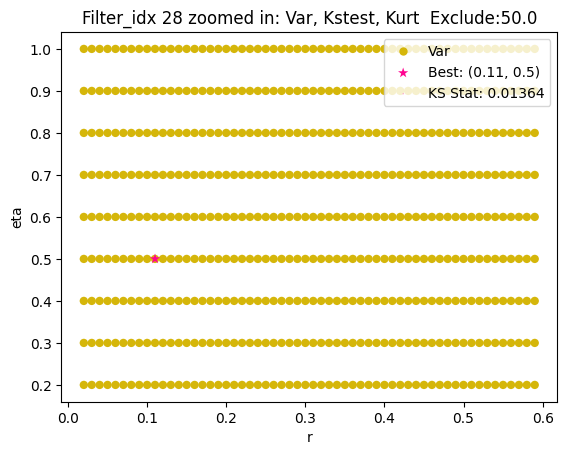

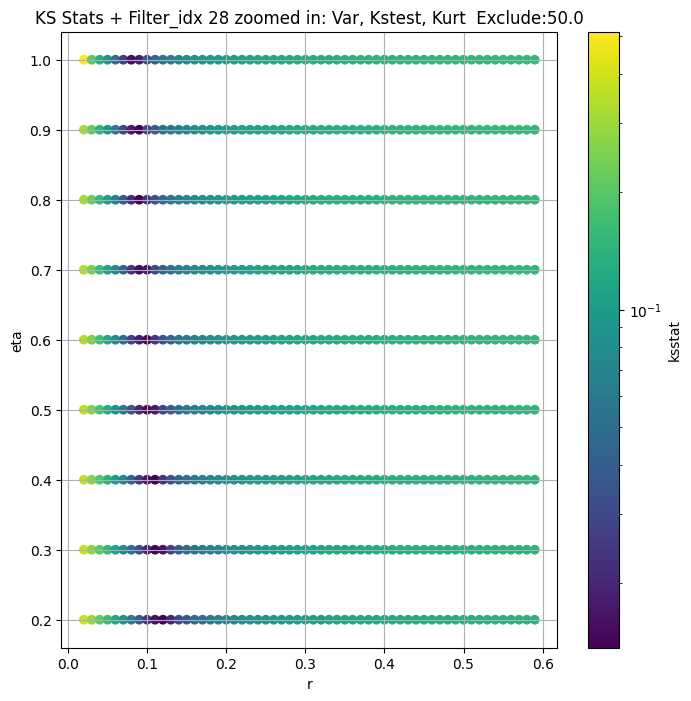

Filter_idx 29


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.029792377126032554, var: 1.719526093413158


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.029537937482179477, var: 1.7503402462479487


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.029868408030883253, var: 1.7839270022009117


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.030308575880952926, var: 1.821385286069653


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.029944727026467832, var: 1.8641021424965896


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.03062099593953782, var: 1.9158612012351002


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.030298558338735793, var: 1.998616060811719
Number of samples: 100000, Without approximation : 7077888.0


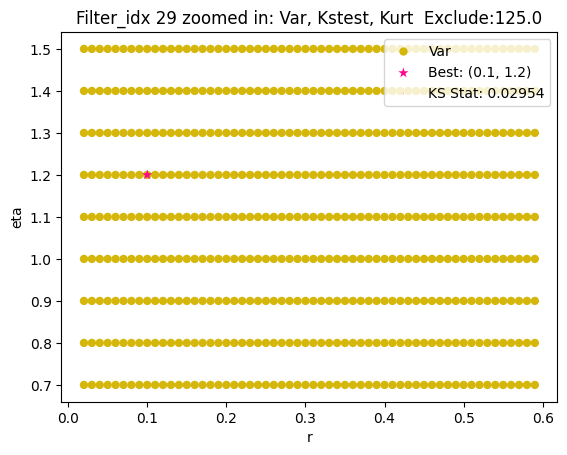

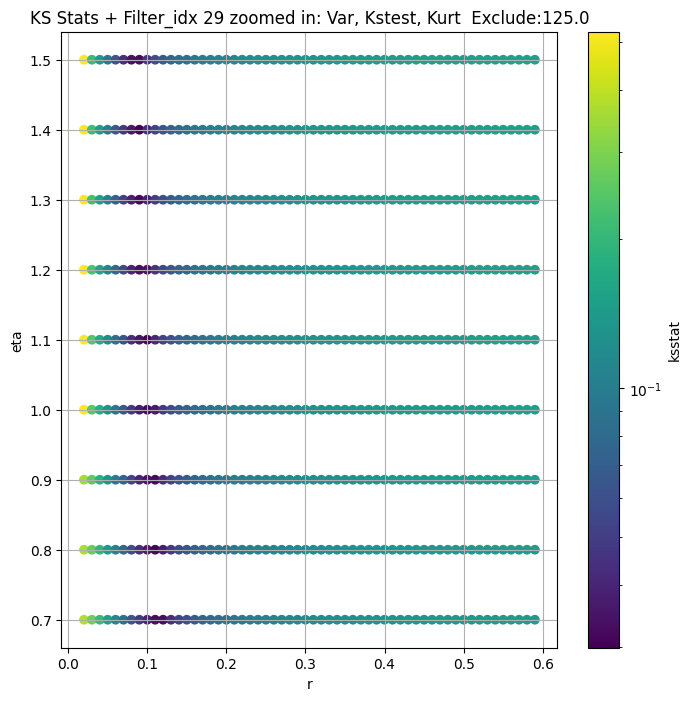

Filter_idx 30


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + 100 = 150, ksstat: 0.013912097862901152, var: 1.566155238855762


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + 75 = 125, ksstat: 0.01375756271769496, var: 1.6020053923422477


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + 50 = 100, ksstat: 0.013756494430978317, var: 1.641646301681303


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + 25 = 75, ksstat: 0.013483420341216079, var: 1.686645769922149


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + 0 = 50, ksstat: 0.013564915954970225, var: 1.7402172334997803


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + -25 = 25, ksstat: 0.01362915433378703, var: 1.808169591898796


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 50.0 + -50 = 0, ksstat: 0.013742354961470526, var: 1.9241323774052796
Number of samples: 100000, Without approximation : 7077888.0


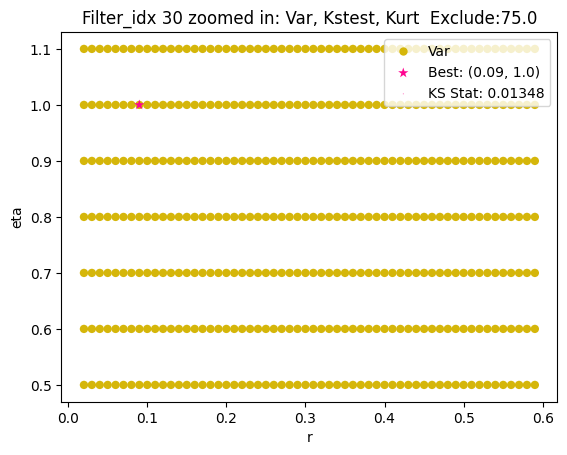

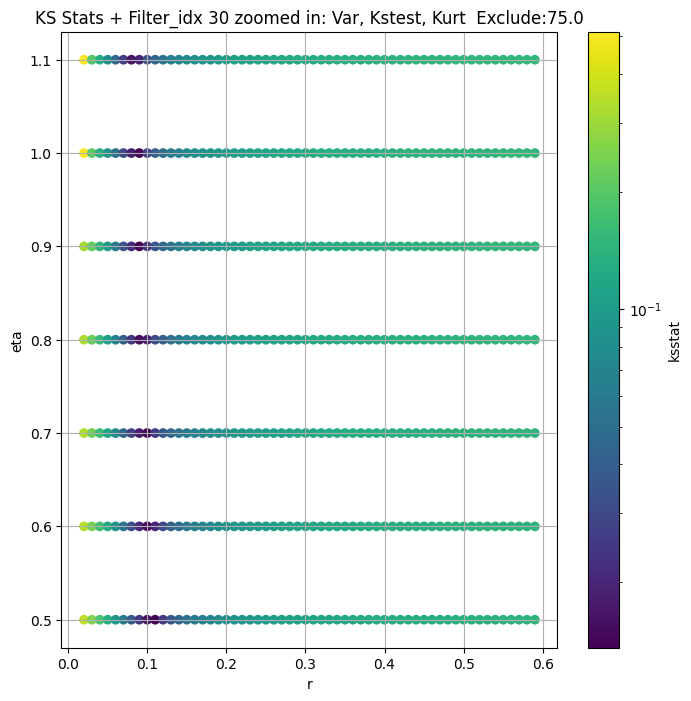

Filter_idx 31


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.04136900637836749, var: 3.220139613748831


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.04136897137298812, var: 3.2566822416350645


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.04136903163707617, var: 3.2956309463931426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.04136902498283279, var: 3.337802233255618


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.04136896803985052, var: 3.3845104403178454


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.04137152697483498, var: 3.438828283314508


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.041370209252327594, var: 3.5192369471892126
Number of samples: 100000, Without approximation : 7077888.0


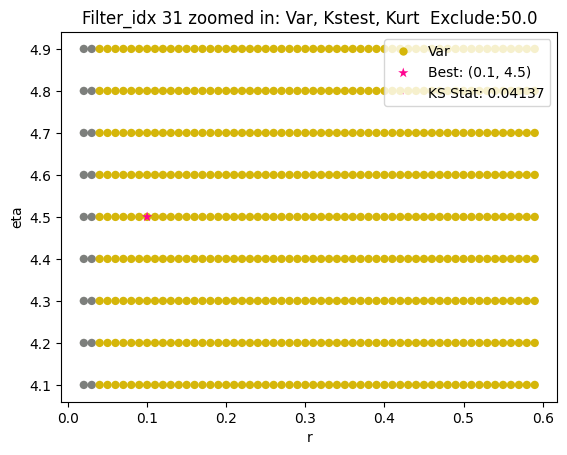

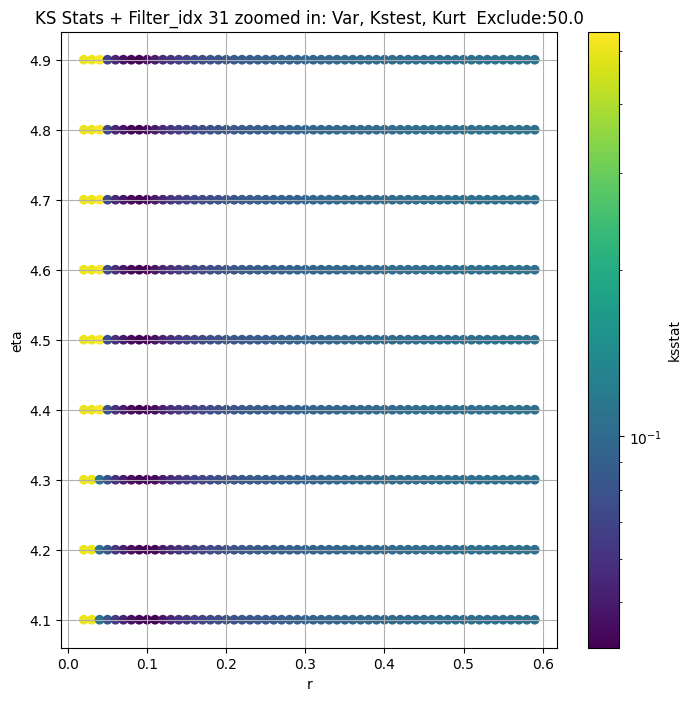

Filter_idx 32


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.016017317279295673, var: 2.6867361137050865


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.01599233061313554, var: 2.7358503996000323


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.01607621495565309, var: 2.7921614500810765


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.015664193546103877, var: 2.860983376410221


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.015730504716461036, var: 2.9683500978153154
Number of samples: 100000, Without approximation : 7077888.0


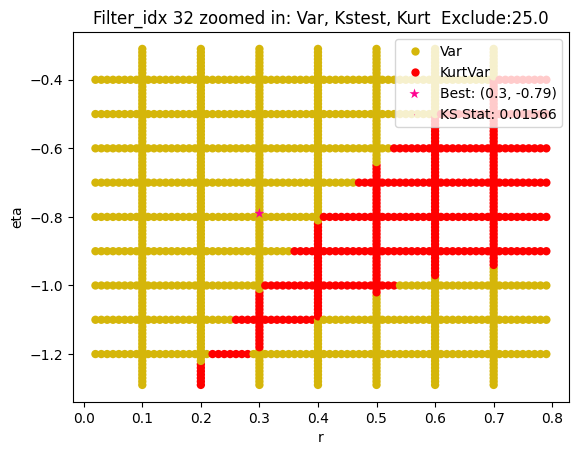

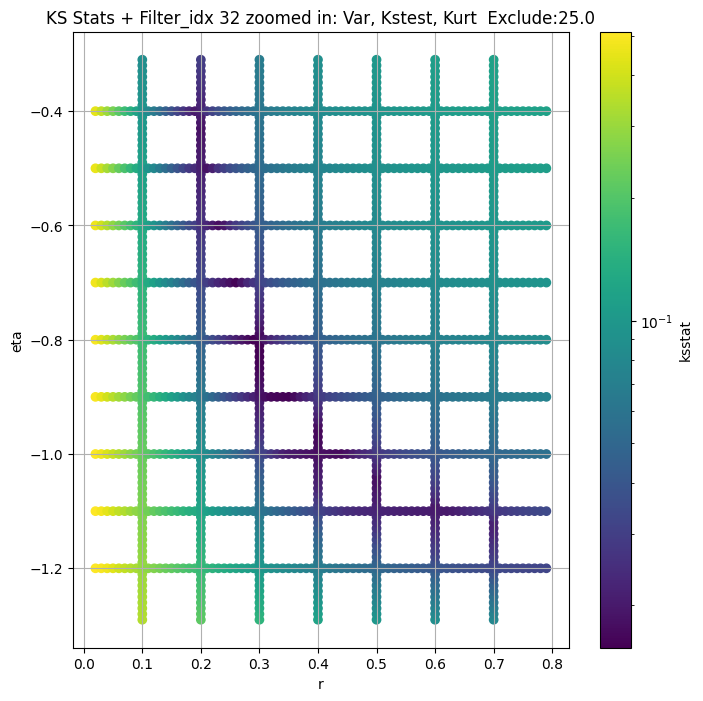

Filter_idx 33


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + 100 = 150, ksstat: 0.00681846985461565, var: 0.9381437035997715


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + 75 = 125, ksstat: 0.006399562156245708, var: 0.9564937077929615


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + 50 = 100, ksstat: 0.0063337109487306975, var: 0.9766714637994645


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + 25 = 75, ksstat: 0.006060924160162018, var: 0.9992671115786884


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + 0 = 50, ksstat: 0.005521674286561862, var: 1.0253594672087303


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + -25 = 25, ksstat: 0.0054815288642565685, var: 1.0574446699085907


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 33, 50.0 + -50 = 0, ksstat: 0.004783914101949005, var: 1.1126750934445624
Number of samples: 100000, Without approximation : 7077888.0


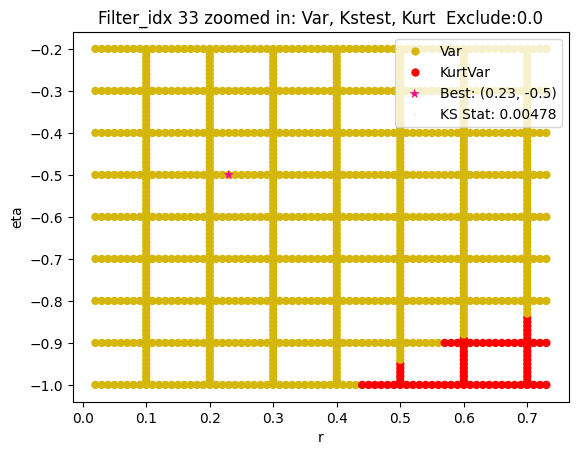

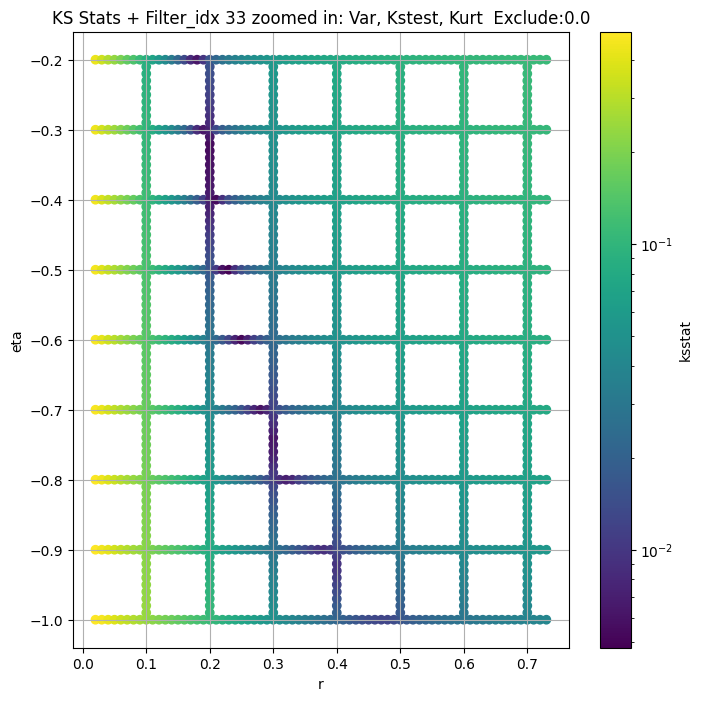

Filter_idx 34


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 100 = 100, ksstat: 0.008717806880528145, var: 1.7385663373159161


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 75 = 75, ksstat: 0.008462960525672747, var: 1.7816339172136464


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 50 = 50, ksstat: 0.00854016725244855, var: 1.8318634511425096


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 25 = 25, ksstat: 0.008244631919656742, var: 1.8943400413599383


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 0 = 0, ksstat: 0.00789520804179833, var: 1.9991184787766472
Number of samples: 100000, Without approximation : 7077888.0


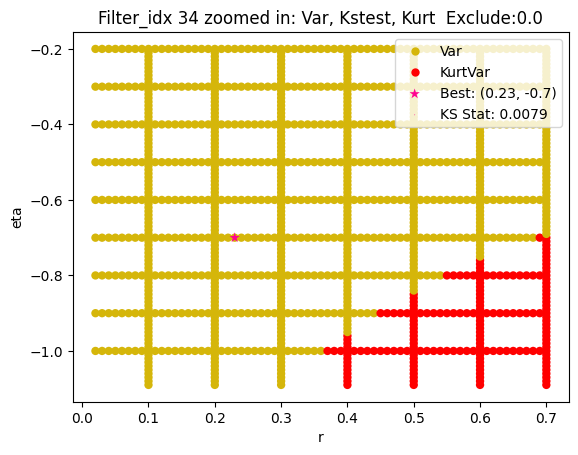

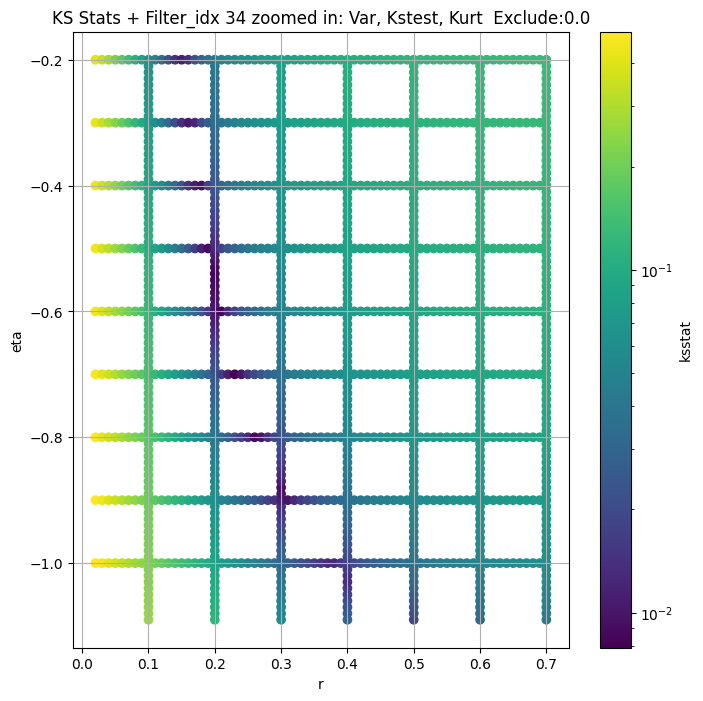

Filter_idx 38


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.01529389714377366, var: 5.154618543923408


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.01528732793712606, var: 5.265970850070558


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.015280170472399546, var: 5.3914147362430835


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.015277054244135224, var: 5.538835775243614


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.015276229514496809, var: 5.7485084492826575
Number of samples: 100000, Without approximation : 7077888.0


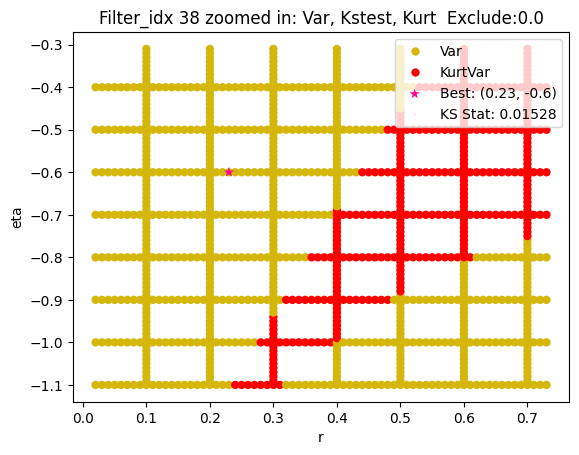

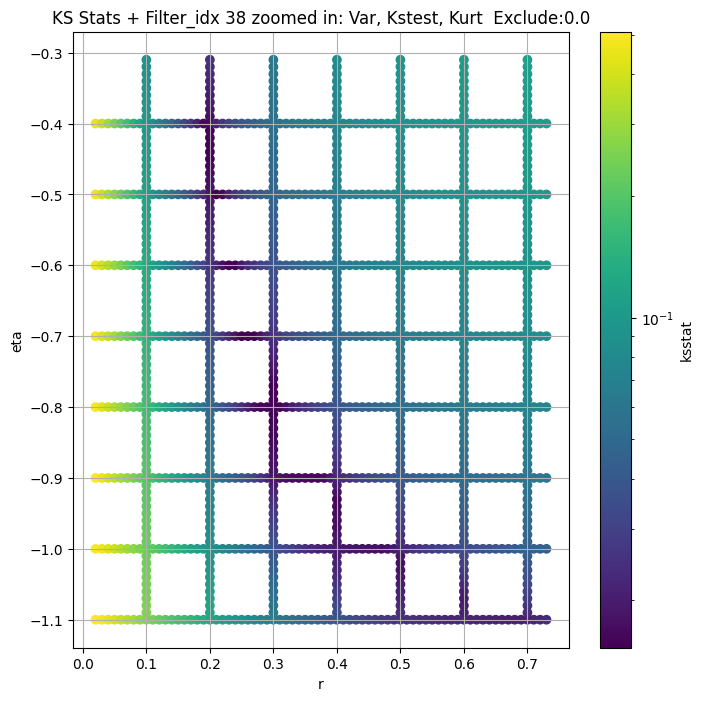

Filter_idx 39


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 100 = 300, ksstat: 0.04524071753541187, var: 3.448227276957065


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 75 = 275, ksstat: 0.04527744438308001, var: 3.480340887460077


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 50 = 250, ksstat: 0.04534952281376353, var: 3.513732052352561


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 25 = 225, ksstat: 0.04537375359637724, var: 3.548534358450146


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 0 = 200, ksstat: 0.045397493303935665, var: 3.5849149912569005


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -25 = 175, ksstat: 0.04542030930447227, var: 3.623084157911634


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -50 = 150, ksstat: 0.04544153359388042, var: 3.663333048128343


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -75 = 125, ksstat: 0.04546005637530076, var: 3.706100643116377


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -100 = 100, ksstat: 0.045474222527389474, var: 3.7520149083610392
Number of samples: 100000, Without approximation : 7077888.0


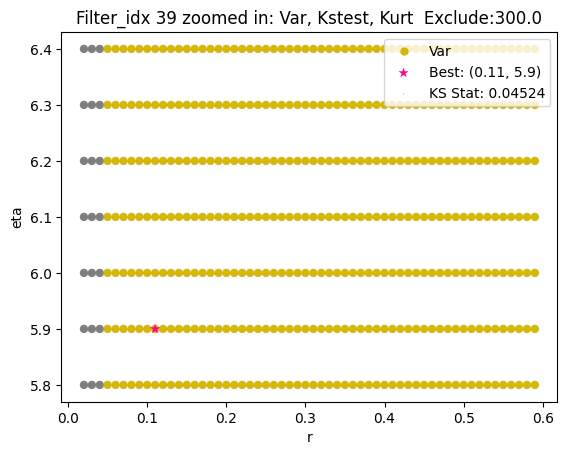

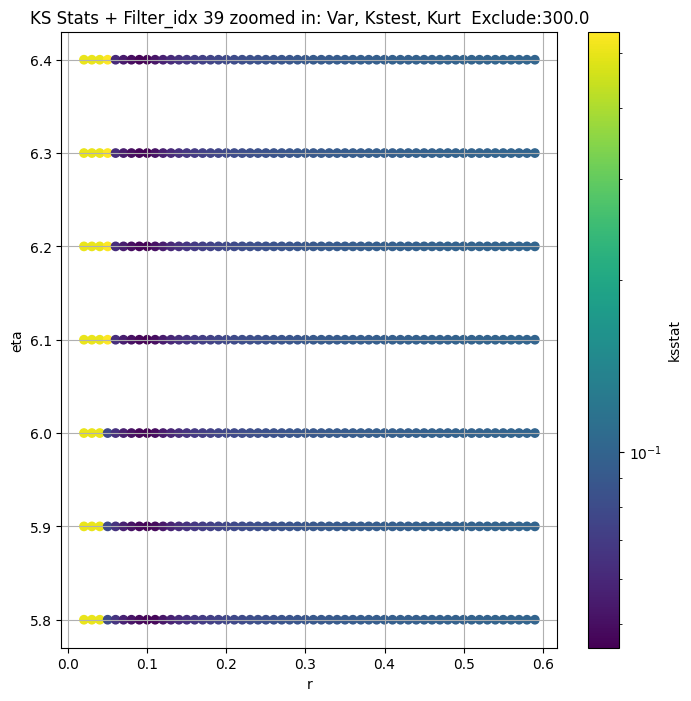

Filter_idx 41


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + 100 = 200, ksstat: 0.009940225648146783, var: 1.5468155010061087


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + 75 = 175, ksstat: 0.00988722359358174, var: 1.574925962739654


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + 50 = 150, ksstat: 0.009747566014451259, var: 1.6051664071364948


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + 25 = 125, ksstat: 0.00963593787812178, var: 1.6379457103443364


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + 0 = 100, ksstat: 0.009615701449972036, var: 1.6739803494093992


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + -25 = 75, ksstat: 0.009614975445903284, var: 1.7144109635201121


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + -50 = 50, ksstat: 0.009621321247355263, var: 1.7614366742887262


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + -75 = 25, ksstat: 0.009613640306262772, var: 1.8194524006213297


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 41, 100.0 + -100 = 0, ksstat: 0.009617764020626973, var: 1.9227614875729109
Number of samples: 100000, Without approximation : 7077888.0


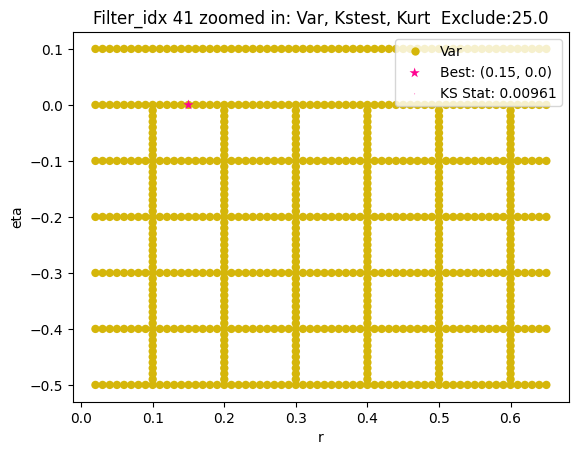

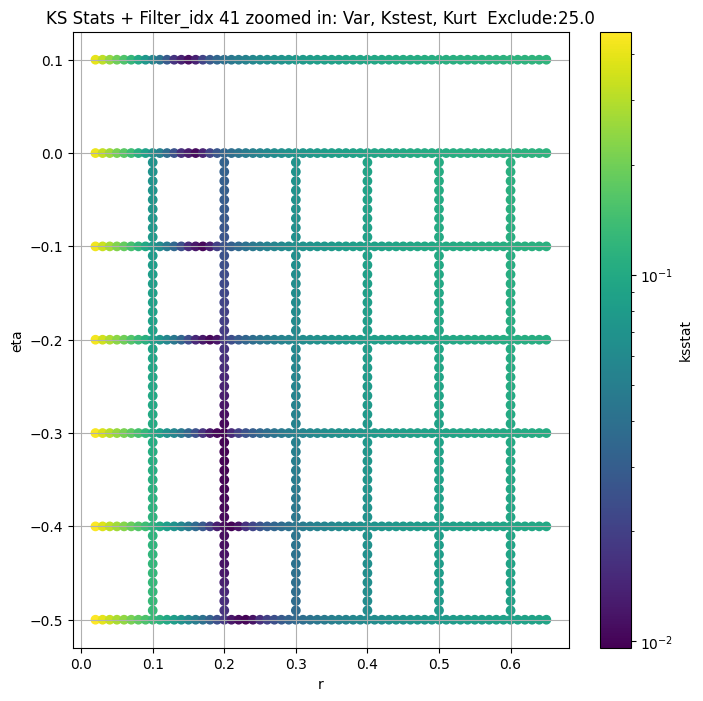

Filter_idx 42


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 42, 0.0 + 100 = 100, ksstat: 0.011329625025633228, var: 4.765528459502572


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 42, 0.0 + 75 = 75, ksstat: 0.011842439657416437, var: 4.932823141329122


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 42, 0.0 + 50 = 50, ksstat: 0.011573912412149223, var: 5.127431675290141


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 42, 0.0 + 25 = 25, ksstat: 0.011172833772472801, var: 5.369664593075104


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 42, 0.0 + 0 = 0, ksstat: 0.010713445703572022, var: 5.739101383182204
Number of samples: 100000, Without approximation : 7077888.0


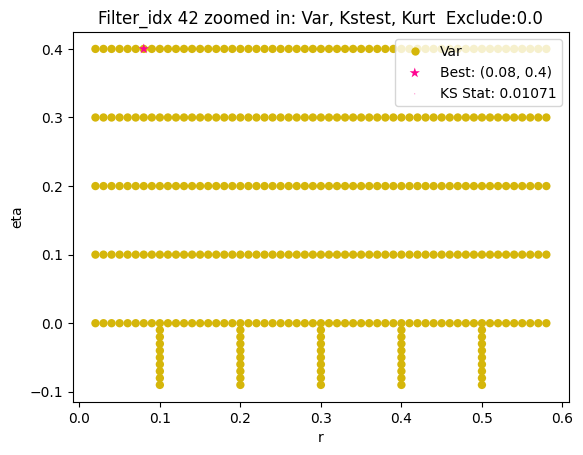

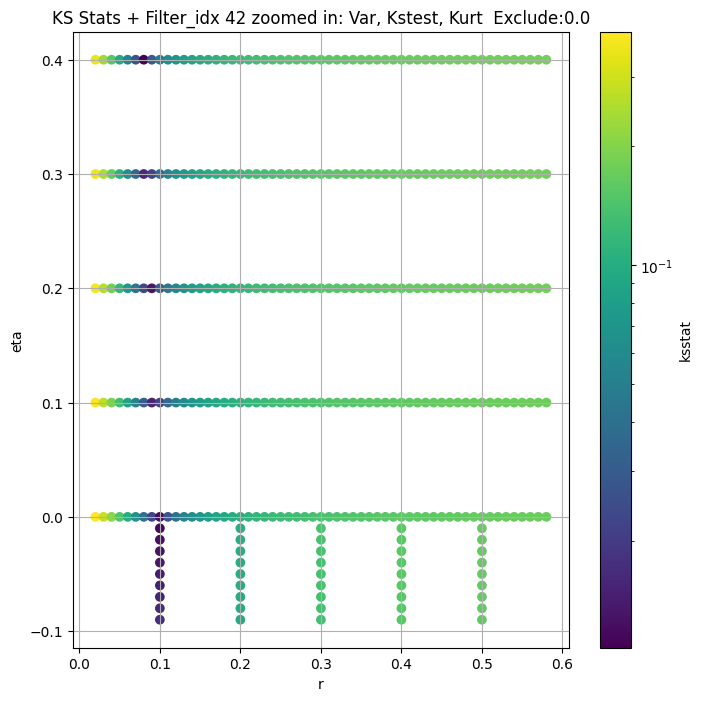

Filter_idx 43


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 43, 0.0 + 100 = 100, ksstat: 0.014091332893529096, var: 1.9981318010766254


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 43, 0.0 + 75 = 75, ksstat: 0.014067230462720015, var: 2.040668078001596


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 43, 0.0 + 50 = 50, ksstat: 0.014058592443849272, var: 2.089089952396424


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 43, 0.0 + 25 = 25, ksstat: 0.014149860753690235, var: 2.148203445654724


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 43, 0.0 + 0 = 0, ksstat: 0.014065842469260459, var: 2.2440398466645113
Number of samples: 100000, Without approximation : 7077888.0


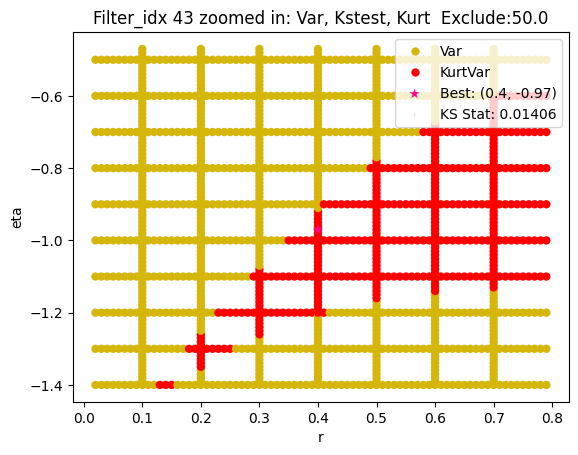

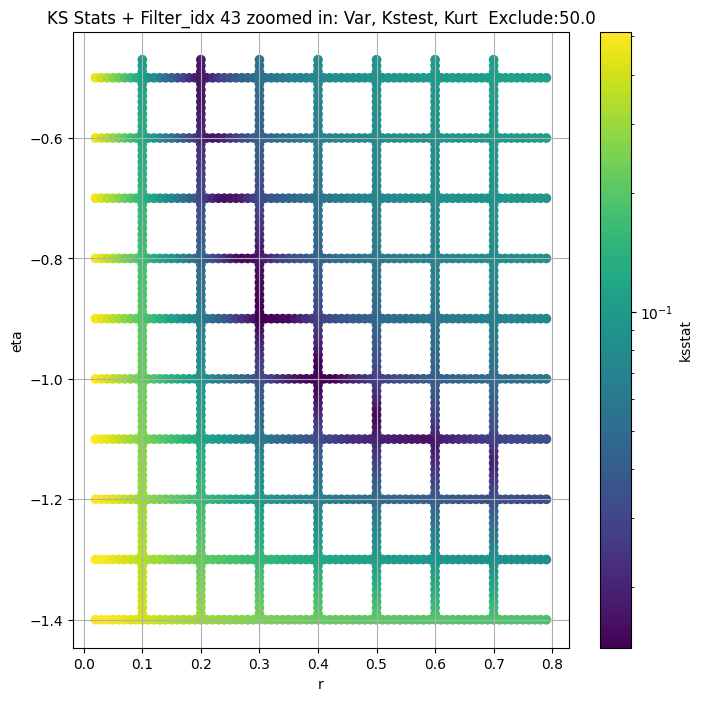

Filter_idx 44


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + 100 = 150, ksstat: 0.012242599358250894, var: 4.0136679712216266


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + 75 = 125, ksstat: 0.0122264381531772, var: 4.117356091986953


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + 50 = 100, ksstat: 0.011605610066475813, var: 4.231281196498799


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + 25 = 75, ksstat: 0.01142330111982115, var: 4.35881926758824


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + 0 = 50, ksstat: 0.01152942234671217, var: 4.505302866434404


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + -25 = 25, ksstat: 0.011371961191901092, var: 4.687586432770326


  0%|          | 0/715 [00:00<?, ?it/s]

Finding Minimum after computing 715 CDFs
filter_idx 44, 50.0 + -50 = 0, ksstat: 0.012311718899025714, var: 4.972346732822326
Number of samples: 100000, Without approximation : 7077888.0


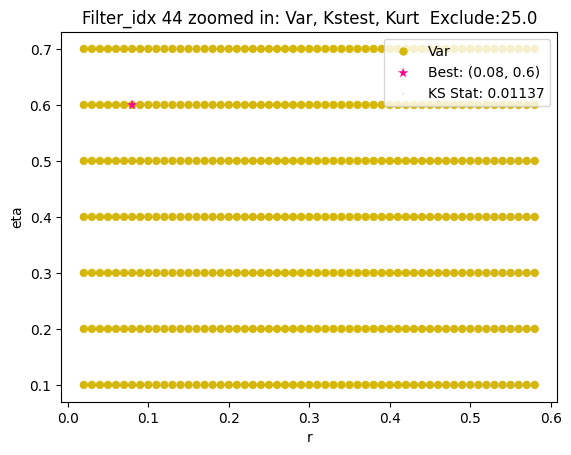

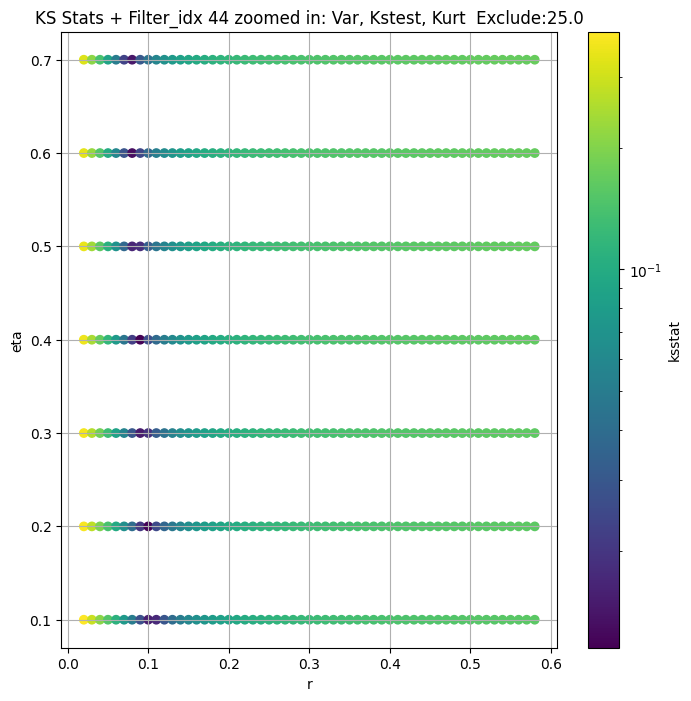

Filter_idx 45


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + 100 = 300, ksstat: 0.02734713085338042, var: 2.3429789498716445


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + 75 = 275, ksstat: 0.02727034317103566, var: 2.371118499028929


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + 50 = 250, ksstat: 0.0271976624752312, var: 2.4004610965938675


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + 25 = 225, ksstat: 0.02752263845887898, var: 2.4311242669343787


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + 0 = 200, ksstat: 0.027396727540803967, var: 2.463296044355139


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + -25 = 175, ksstat: 0.02729769552274519, var: 2.497175091015447


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + -50 = 150, ksstat: 0.027318977170729453, var: 2.533054624050292


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + -75 = 125, ksstat: 0.027549922594719667, var: 2.5712748686735325


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 200.0 + -100 = 100, ksstat: 0.027397856453529656, var: 2.61242476117597
Number of samples: 100000, Without approximation : 7077888.0


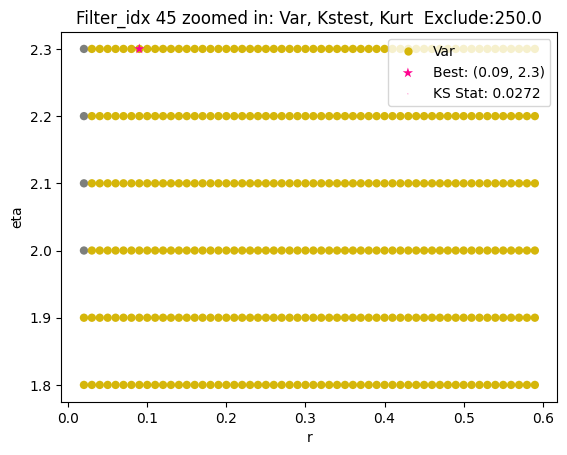

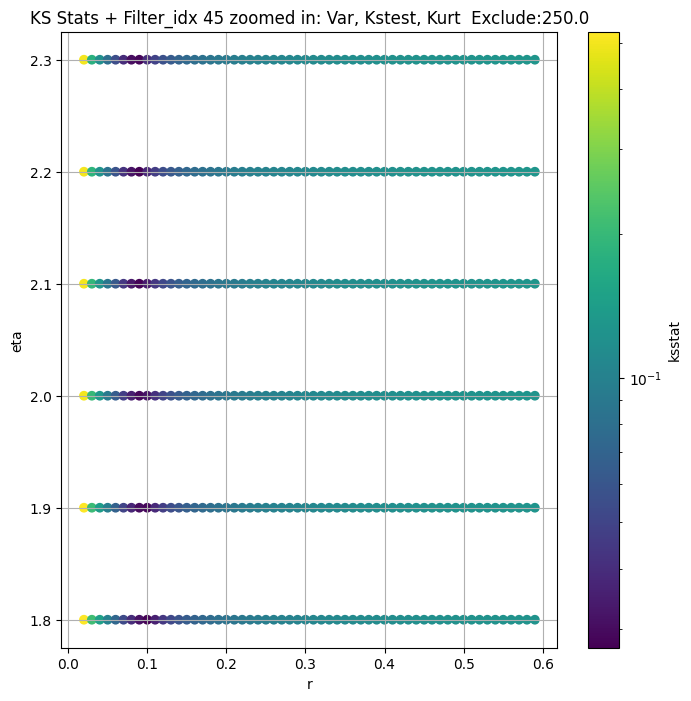

Filter_idx 46


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + 100 = 200, ksstat: 0.022885631188970024, var: 2.1349568254687408


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + 75 = 175, ksstat: 0.02284133713679465, var: 2.1564500630629535


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + 50 = 150, ksstat: 0.022915048502228363, var: 2.179094763607478


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + 25 = 125, ksstat: 0.022969333507515954, var: 2.2031396881851415


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + 0 = 100, ksstat: 0.02303413735045412, var: 2.228914414582645


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + -25 = 75, ksstat: 0.023066456088071452, var: 2.256934010457869


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + -50 = 50, ksstat: 0.023223549715035707, var: 2.2880346824799136


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + -75 = 25, ksstat: 0.023318256026337858, var: 2.323938016646314


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 46, 100.0 + -100 = 0, ksstat: 0.02336173451137724, var: 2.3742495423909977
Number of samples: 100000, Without approximation : 7077888.0


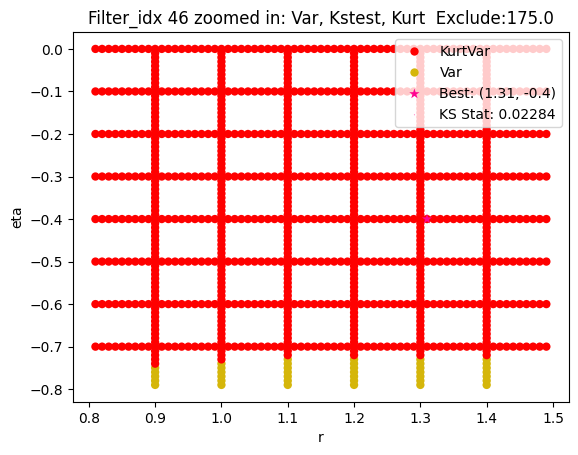

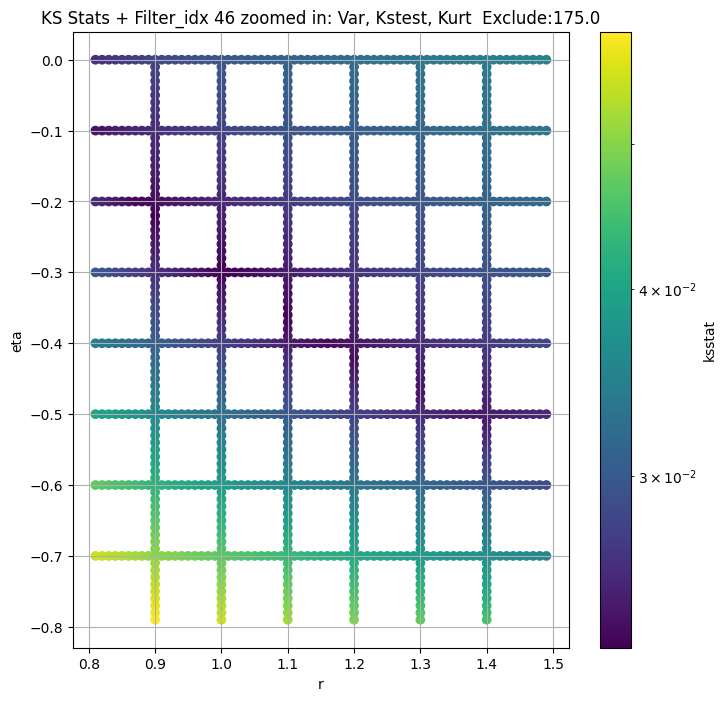

Filter_idx 47


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 47, 0.0 + 100 = 100, ksstat: 0.008261093739058811, var: 4.813555082990138


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 47, 0.0 + 75 = 75, ksstat: 0.008111223579951476, var: 4.891829691011681


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 47, 0.0 + 50 = 50, ksstat: 0.007722356236485983, var: 4.97716241253637


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 47, 0.0 + 25 = 25, ksstat: 0.0076835260525102145, var: 5.073399587250511


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 47, 0.0 + 0 = 0, ksstat: 0.007786842536415095, var: 5.208515082043805
Number of samples: 100000, Without approximation : 7077888.0


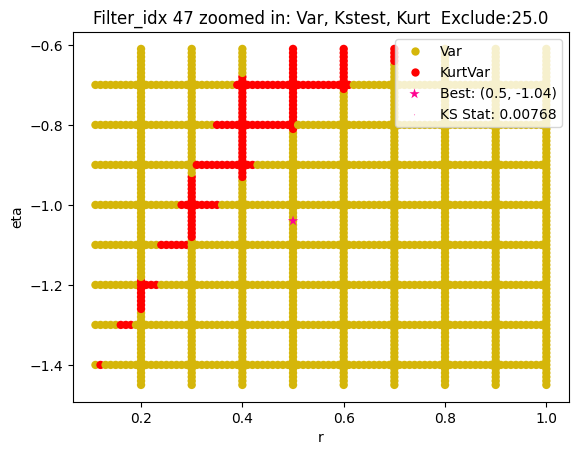

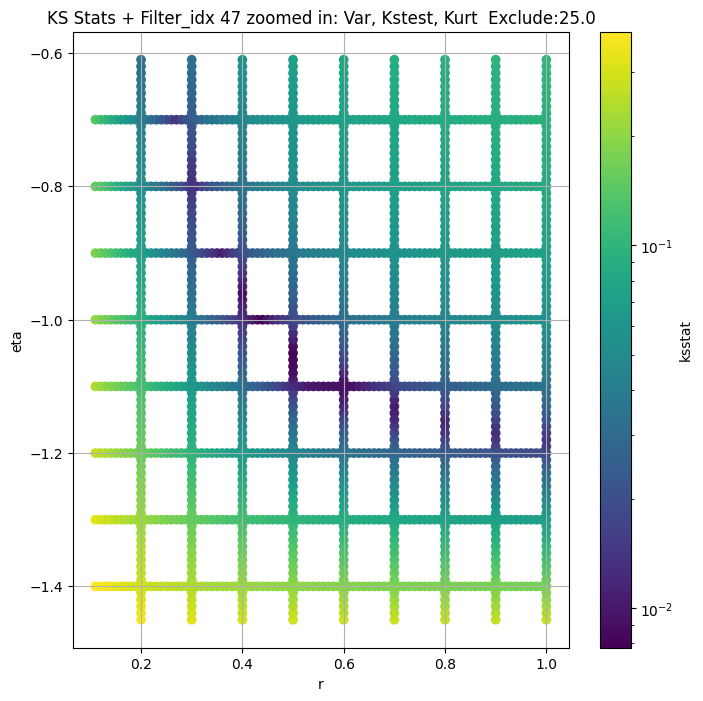

Filter_idx 48


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 100 = 300, ksstat: 0.023747631587309193, var: 1.220050817809888


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 75 = 275, ksstat: 0.023756767385748945, var: 1.2425393126439124


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 50 = 250, ksstat: 0.023725648804395316, var: 1.266333828866762


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 25 = 225, ksstat: 0.024039309791421715, var: 1.2915881420176256


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 0 = 200, ksstat: 0.023829794984870423, var: 1.3184991177078886


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -25 = 175, ksstat: 0.023967366397315004, var: 1.3472646977967806


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -50 = 150, ksstat: 0.02435388692110413, var: 1.3782575829532917


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -75 = 125, ksstat: 0.02406501284347884, var: 1.4119752696659005


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -100 = 100, ksstat: 0.02442459515969636, var: 1.4490547805108946
Number of samples: 100000, Without approximation : 7077888.0


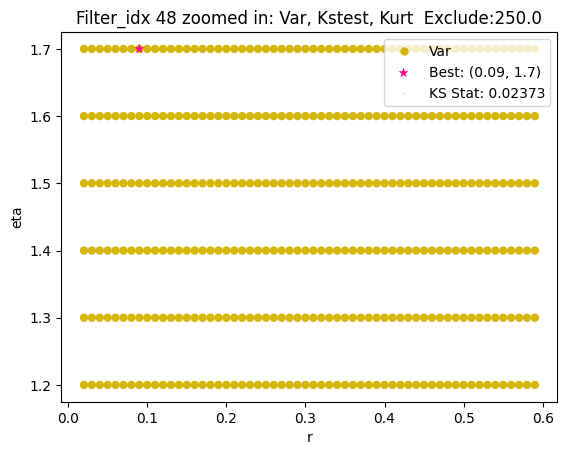

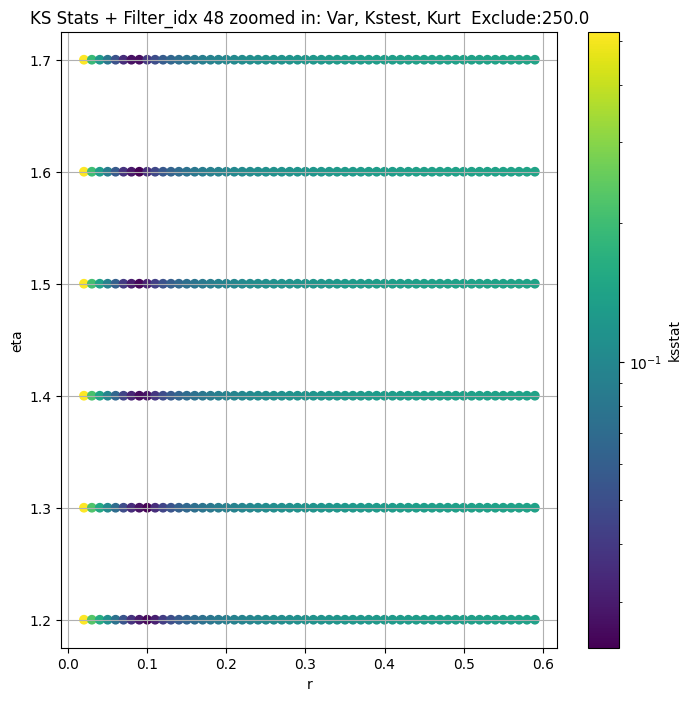

Filter_idx 49


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 49, 0.0 + 100 = 100, ksstat: 0.020774425044139955, var: 4.139483875164025


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 49, 0.0 + 75 = 75, ksstat: 0.020533727052735484, var: 4.2305508136529895


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 49, 0.0 + 50 = 50, ksstat: 0.02053743091315141, var: 4.333474460796999


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 49, 0.0 + 25 = 25, ksstat: 0.021028521041473458, var: 4.455575795616288


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 49, 0.0 + 0 = 0, ksstat: 0.02040838132756817, var: 4.6459784859976025
Number of samples: 100000, Without approximation : 7077888.0


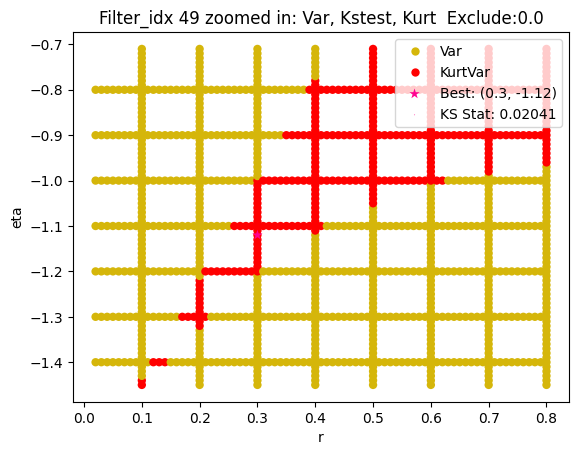

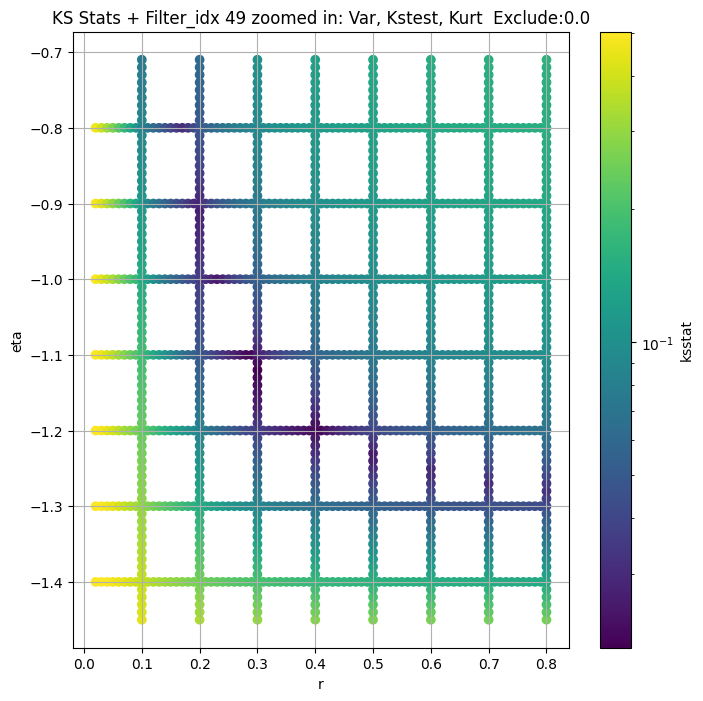

Filter_idx 50


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + 100 = 200, ksstat: 0.025163602448012967, var: 2.7865471283599397


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + 75 = 175, ksstat: 0.02516638766001622, var: 2.834680319366897


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + 50 = 150, ksstat: 0.02515624188693316, var: 2.886287043800397


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + 25 = 125, ksstat: 0.025154217367512888, var: 2.9421934488744506


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + 0 = 100, ksstat: 0.025154826695289456, var: 3.003300790246079


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + -25 = 75, ksstat: 0.02515426907313356, var: 3.0710029526214924


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + -50 = 50, ksstat: 0.0251624708218654, var: 3.148104163409015


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + -75 = 25, ksstat: 0.025154851554866853, var: 3.2421119862907237


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 50, 100.0 + -100 = 0, ksstat: 0.02515416480096705, var: 3.3959494245828745
Number of samples: 100000, Without approximation : 7077888.0


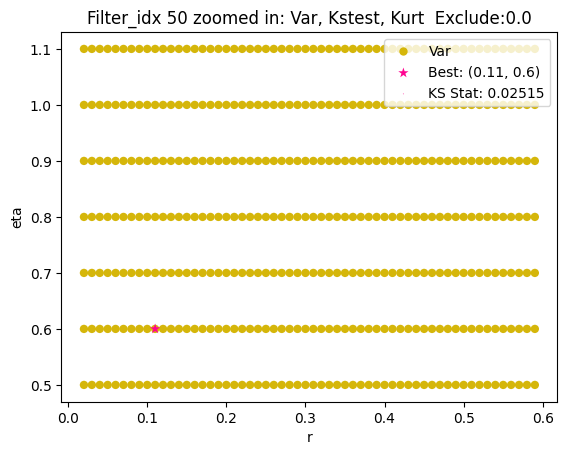

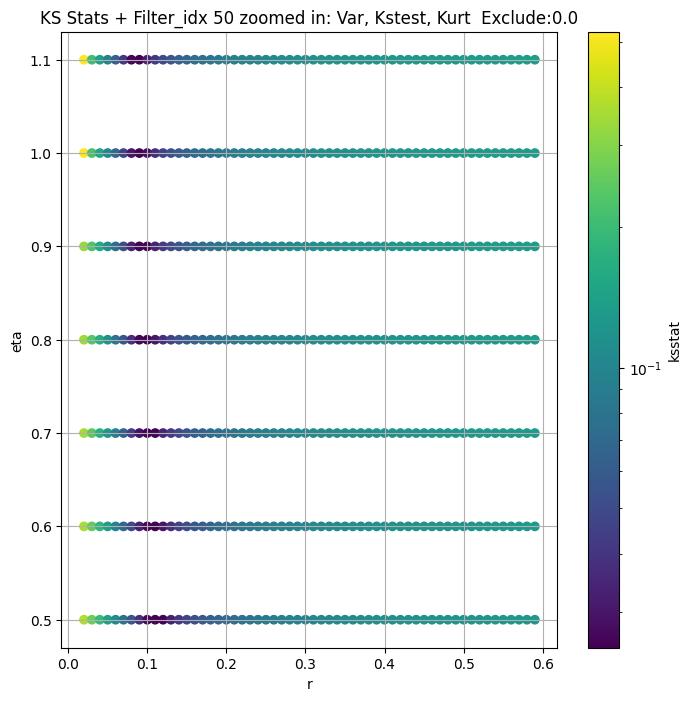

Filter_idx 52


  0%|          | 0/10 [00:00<?, ?it/s]

Finding Minimum after computing 10 CDFs
filter_idx 52, 0.0 + 100 = 100, ksstat: 0.02214441969760672, var: 4.252877990643131


  0%|          | 0/10 [00:00<?, ?it/s]

Finding Minimum after computing 10 CDFs
filter_idx 52, 0.0 + 75 = 75, ksstat: 0.02157819261076703, var: 4.2791754003199465


  0%|          | 0/10 [00:00<?, ?it/s]

Finding Minimum after computing 10 CDFs
filter_idx 52, 0.0 + 50 = 50, ksstat: 0.02095014858204189, var: 4.308521836616641


  0%|          | 0/10 [00:00<?, ?it/s]

Finding Minimum after computing 10 CDFs
filter_idx 52, 0.0 + 25 = 25, ksstat: 0.02021888422388224, var: 4.342909864199154


  0%|          | 0/10 [00:00<?, ?it/s]

Finding Minimum after computing 10 CDFs
filter_idx 52, 0.0 + 0 = 0, ksstat: 0.01938239352441723, var: 4.391846107575936
Number of samples: 100000, Without approximation : 7077888.0


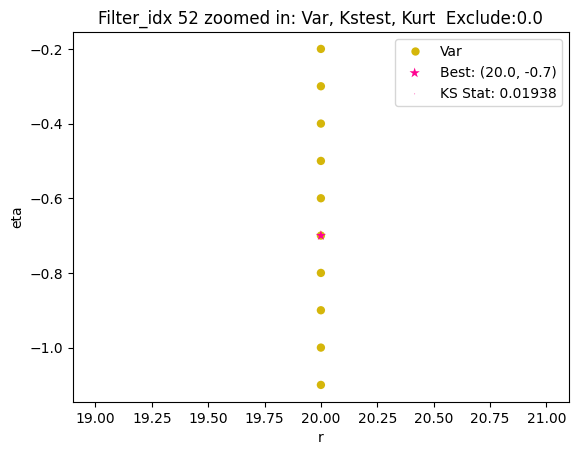

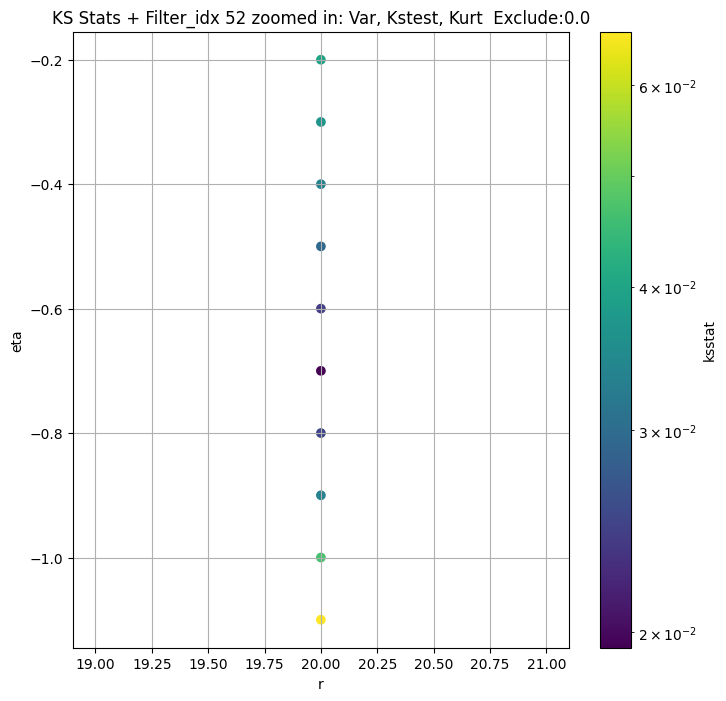

Filter_idx 54


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + 100 = 150, ksstat: 0.0050334244115756155, var: 0.6255156840680405


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + 75 = 125, ksstat: 0.005122893206726764, var: 0.6402513810160733


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + 50 = 100, ksstat: 0.005116413265515707, var: 0.6565466358484576


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + 25 = 75, ksstat: 0.004413847593566, var: 0.6752638090914752


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + 0 = 50, ksstat: 0.004413788352800152, var: 0.6971145247940893


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + -25 = 25, ksstat: 0.003568291373655552, var: 0.7254381092922761


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 54, 50.0 + -50 = 0, ksstat: 0.003956341804305263, var: 0.7849785709010645
Number of samples: 100000, Without approximation : 7077888.0


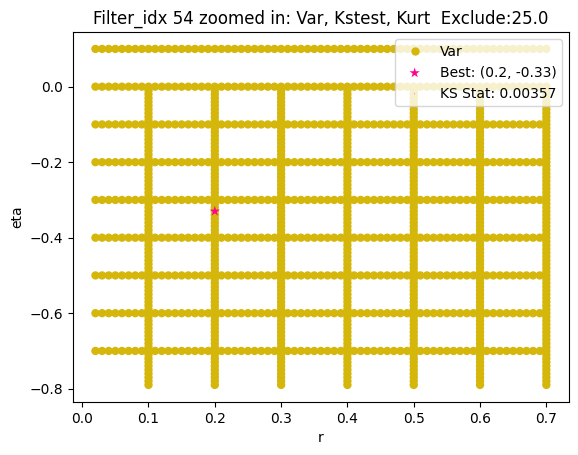

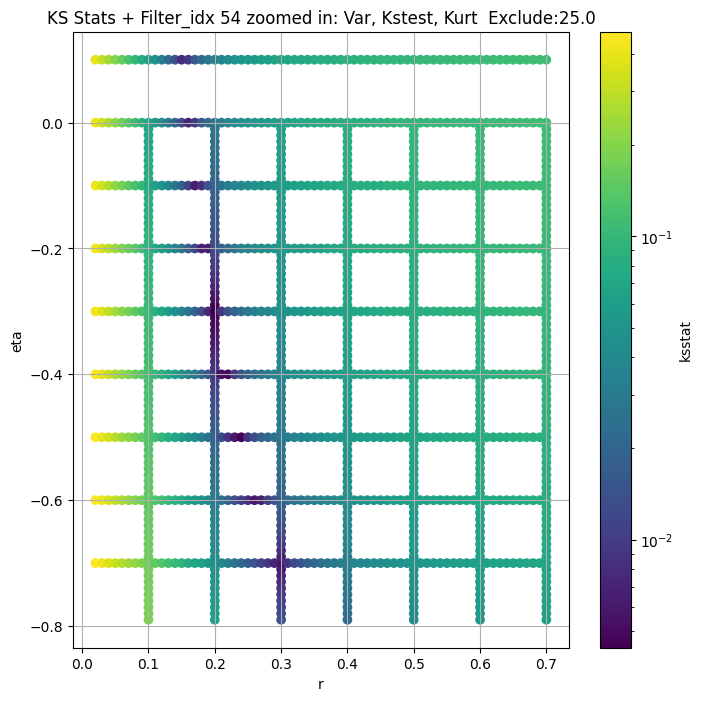

Filter_idx 55


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + 100 = 150, ksstat: 0.013000281200302166, var: 1.8554351360755568


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + 75 = 125, ksstat: 0.012538650951884778, var: 1.8951313589086334


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + 50 = 100, ksstat: 0.012571428929301576, var: 1.9388893452640361


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + 25 = 75, ksstat: 0.012545472492065224, var: 1.9880216970915614


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + 0 = 50, ksstat: 0.012534251391265017, var: 2.044923614421398


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + -25 = 25, ksstat: 0.012534940120693616, var: 2.115040870952817


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 55, 50.0 + -50 = 0, ksstat: 0.01254022296095686, var: 2.2370209163891293
Number of samples: 100000, Without approximation : 7077888.0


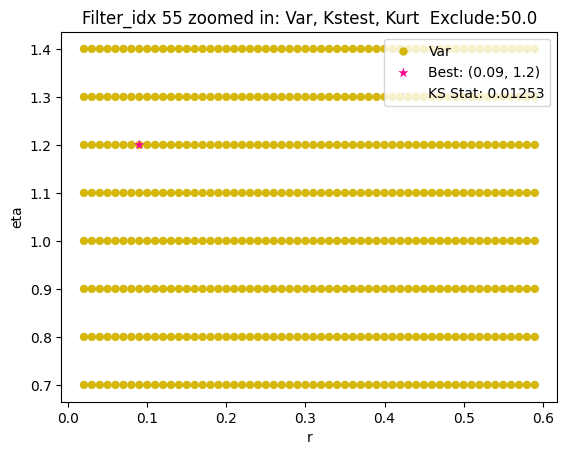

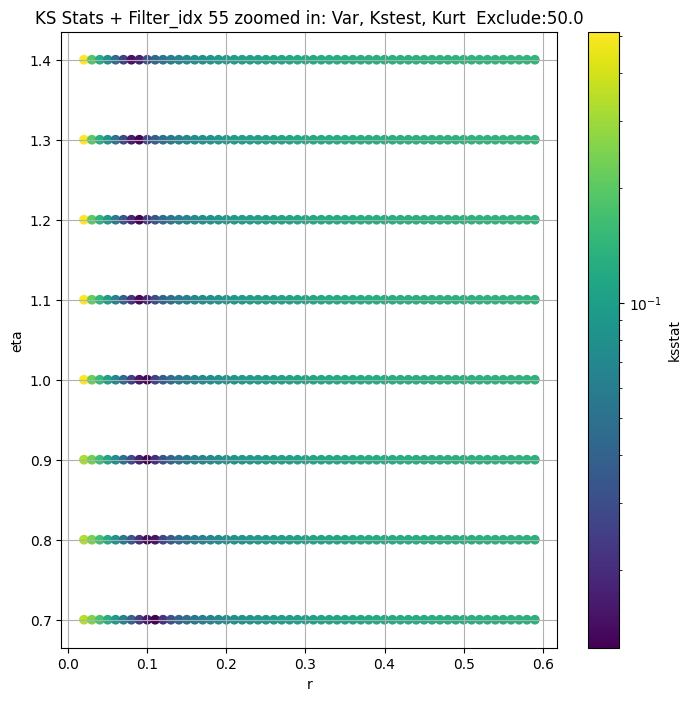

Filter_idx 56


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 56, 0.0 + 100 = 100, ksstat: 0.016892635389028077, var: 5.587694775713412


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 56, 0.0 + 75 = 75, ksstat: 0.016138074053520968, var: 5.719317199369653


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 56, 0.0 + 50 = 50, ksstat: 0.016834679656675733, var: 5.8660487243695405


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 56, 0.0 + 25 = 25, ksstat: 0.016177439914985325, var: 6.0354104899626355


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 56, 0.0 + 0 = 0, ksstat: 0.015564914350896464, var: 6.2665209258935946
Number of samples: 100000, Without approximation : 7077888.0


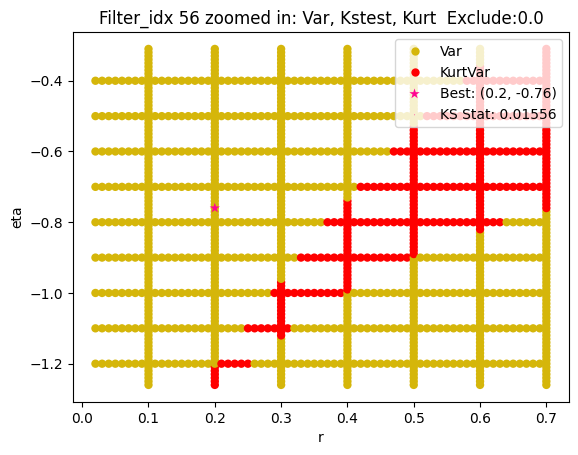

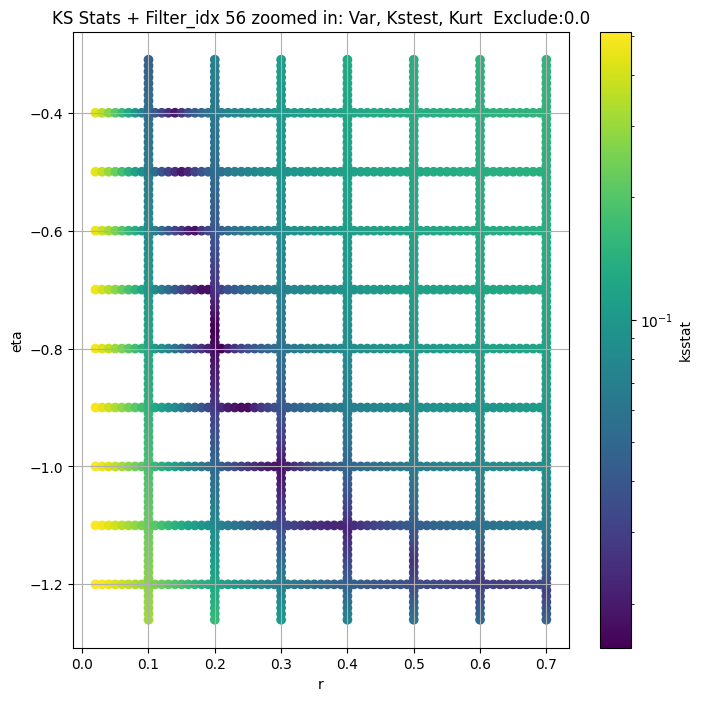

Filter_idx 57


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 57, 0.0 + 100 = 100, ksstat: 0.010760435720971628, var: 2.4677853700133


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 57, 0.0 + 75 = 75, ksstat: 0.010708427382846164, var: 2.5253937187463986


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 57, 0.0 + 50 = 50, ksstat: 0.010673304496000846, var: 2.591567093228232


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 57, 0.0 + 25 = 25, ksstat: 0.010577132332548256, var: 2.672449828842635


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 57, 0.0 + 0 = 0, ksstat: 0.010639660199132983, var: 2.811922432076321
Number of samples: 100000, Without approximation : 7077888.0


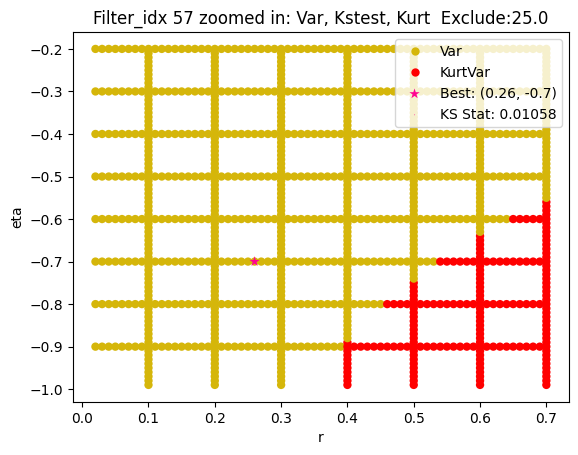

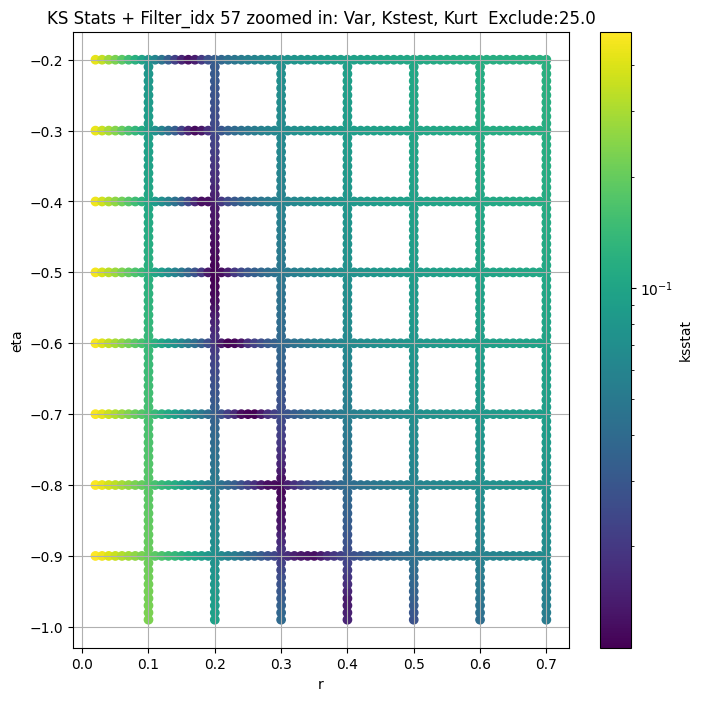

Filter_idx 59


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 59, 0.0 + 100 = 100, ksstat: 0.012719147690135435, var: 4.964332899020455


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 59, 0.0 + 75 = 75, ksstat: 0.012714505619528305, var: 5.071961960745161


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 59, 0.0 + 50 = 50, ksstat: 0.012713950716312039, var: 5.194072207841353


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 59, 0.0 + 25 = 25, ksstat: 0.0127220470206178, var: 5.3405940707365405


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 59, 0.0 + 0 = 0, ksstat: 0.012747096870562247, var: 5.558433385378191
Number of samples: 100000, Without approximation : 7077888.0


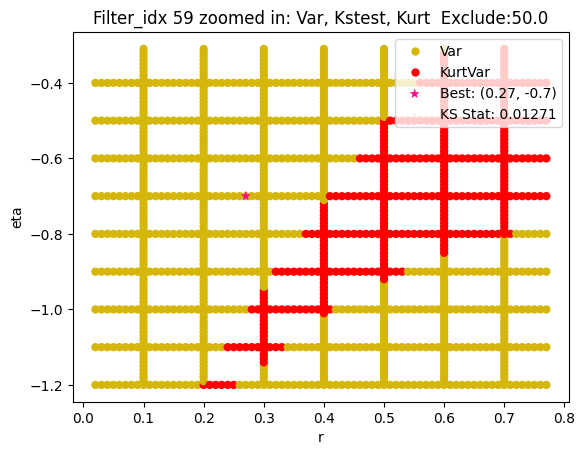

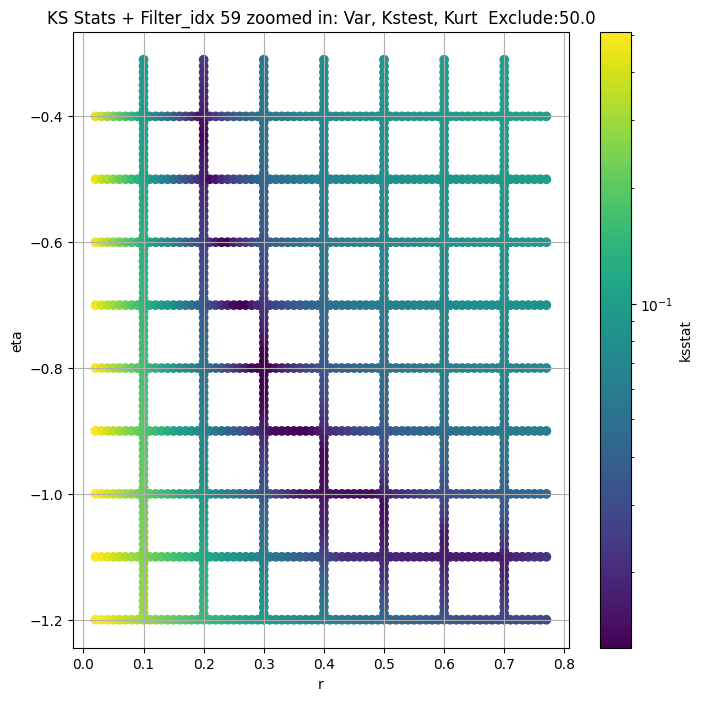

Filter_idx 60


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + 100 = 300, ksstat: 0.024151111461191394, var: 0.1863197205506687


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + 75 = 275, ksstat: 0.024174084048196542, var: 0.18858832823131585


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + 50 = 250, ksstat: 0.02424476235613071, var: 0.19097526018504074


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + 25 = 225, ksstat: 0.024196694399614804, var: 0.1934965274103223


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + 0 = 200, ksstat: 0.024222147505048724, var: 0.19616737226159733


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + -25 = 175, ksstat: 0.024280526920308687, var: 0.1990142130439717


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + -50 = 150, ksstat: 0.024252294476087455, var: 0.2020691689553982


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + -75 = 125, ksstat: 0.024351204122687375, var: 0.20538670409436324


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 60, 200.0 + -100 = 100, ksstat: 0.024439151686769467, var: 0.20903452347552992
Number of samples: 100000, Without approximation : 7077888.0


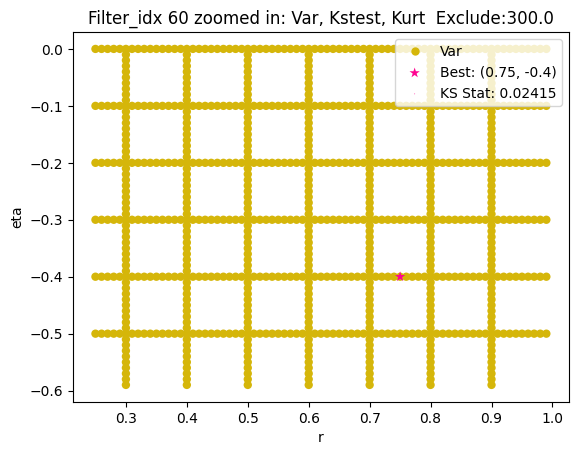

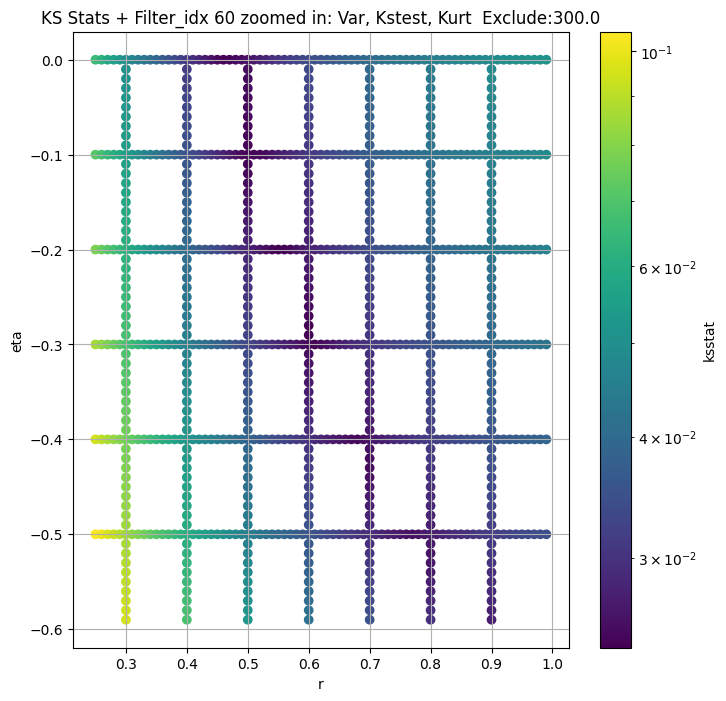

Filter_idx 61


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + 100 = 150, ksstat: 0.013660127953354306, var: 1.5050360375577172


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + 75 = 125, ksstat: 0.013488883061430756, var: 1.53845962066173


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + 50 = 100, ksstat: 0.013636642369291962, var: 1.5756658535435615


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + 25 = 75, ksstat: 0.013522912886473337, var: 1.6179487958924752


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + 0 = 50, ksstat: 0.01351382489338604, var: 1.6677653131048995


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + -25 = 25, ksstat: 0.01360591509888398, var: 1.7293869598038134


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 50.0 + -50 = 0, ksstat: 0.013576132002060093, var: 1.8251313606270814
Number of samples: 100000, Without approximation : 7077888.0


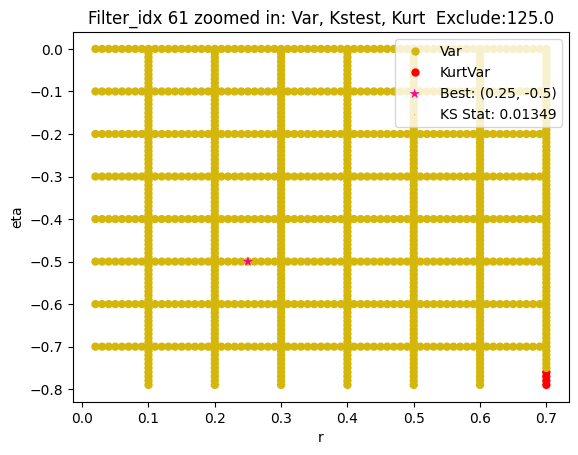

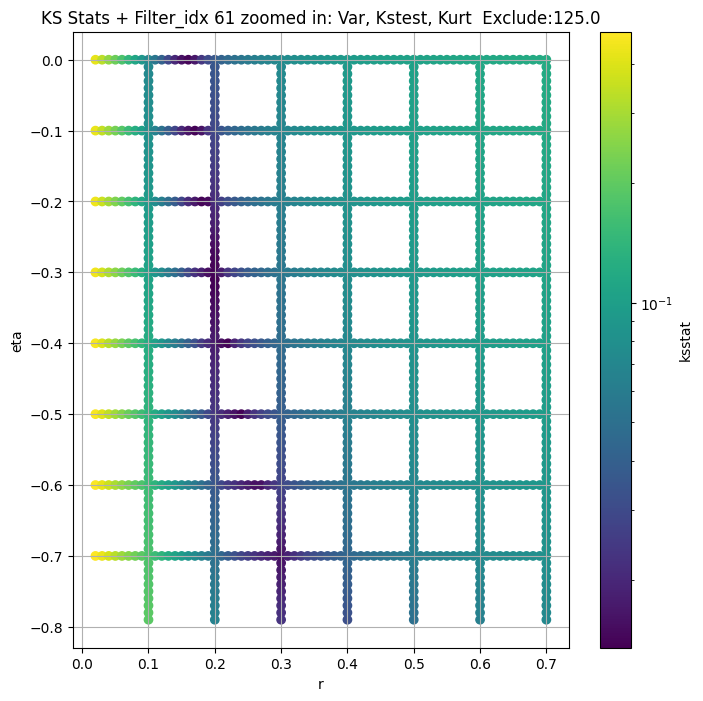

Filter_idx 62


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + 100 = 150, ksstat: 0.02061449366223078, var: 4.352081453378978


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + 75 = 125, ksstat: 0.020792299885376564, var: 4.436169940504061


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + 50 = 100, ksstat: 0.02052023755390553, var: 4.527778890170328


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + 25 = 75, ksstat: 0.02082422722462529, var: 4.629036705695138


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + 0 = 50, ksstat: 0.020825537904936686, var: 4.74406871745132


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + -25 = 25, ksstat: 0.020434702104273672, var: 4.882030132318352


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 50.0 + -50 = 0, ksstat: 0.020431271241406868, var: 5.076604090416857
Number of samples: 100000, Without approximation : 7077888.0


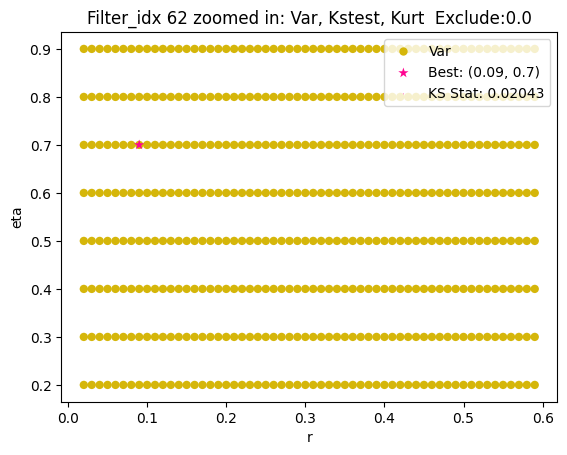

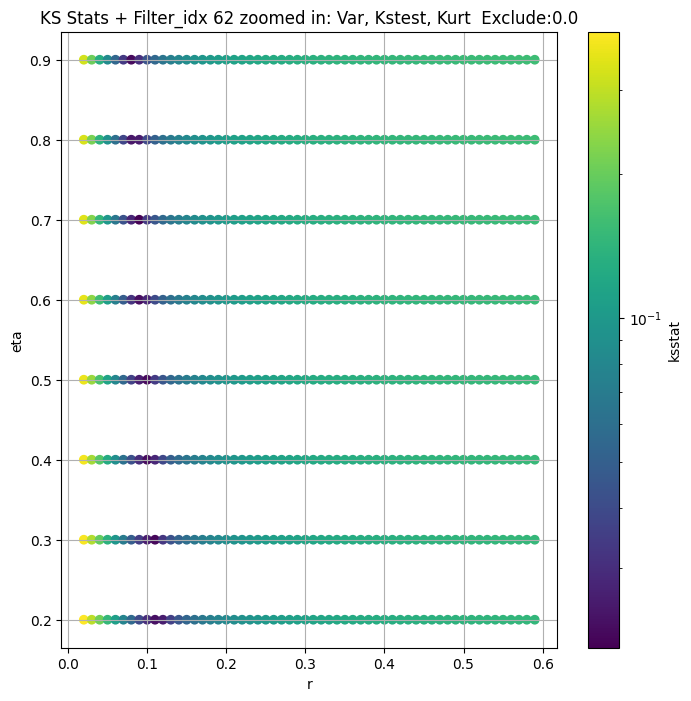

Filter_idx 63


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 0.0 + 100 = 100, ksstat: 0.009009557115240055, var: 0.7987653375314148


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 0.0 + 75 = 75, ksstat: 0.008365112551128595, var: 0.8182626658739793


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 0.0 + 50 = 50, ksstat: 0.008308374539507987, var: 0.8407912142397562


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 0.0 + 25 = 25, ksstat: 0.008199032759262814, var: 0.8685375531355993


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 0.0 + 0 = 0, ksstat: 0.00809939870100157, var: 0.9174416221154434
Number of samples: 100000, Without approximation : 7077888.0


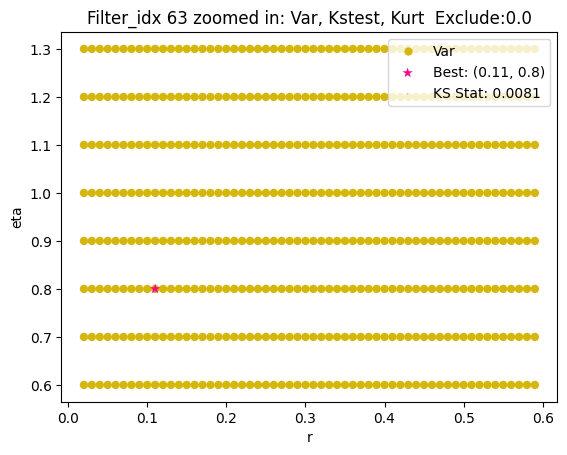

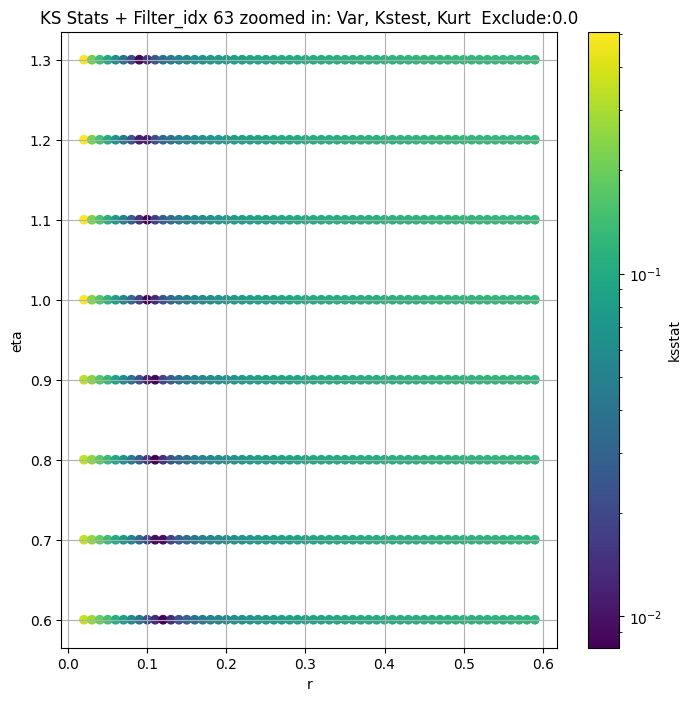

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,4.918292,3.402765,6.778471,14.087733,7.160851,34.707175,7077888.0,dual_color,0.031126,0.1,...,8.494620e-15,200.0,4.374348,0.00051,0.031126,0.09,1.20,3.141475e-17,100.0,1944
2,5.834874,3.930150,8.610619,20.367862,9.880760,60.276031,7077888.0,dual_color,0.022405,0.3,...,2.776016e-01,200.0,4.782265,0.00051,0.020771,0.23,-1.00,1.735770e-02,150.0,4374
3,2.401070,1.665375,3.542346,21.989695,7.956547,102.828290,7077888.0,single_edge,0.006777,0.2,...,1.440289e-04,50.0,2.401070,0.00051,0.006628,0.16,-0.30,1.379921e-06,0.0,41472
4,8.374049,6.064171,10.875553,12.093866,7.784488,19.337828,7077888.0,dual_color,0.022677,0.4,...,3.417791e+00,200.0,7.488520,0.00051,0.022199,0.30,-1.13,5.337540e-01,125.0,3888
5,6.427816,4.854648,7.951692,7.636214,4.954015,14.957260,7077888.0,dual_color,0.021053,0.2,...,2.037893e-04,50.0,6.162587,0.00051,0.020786,0.16,0.00,1.189498e-06,50.0,4374
6,2.961975,2.211630,3.853347,10.482830,4.624699,35.951347,7077888.0,single_edge,0.021525,0.2,...,8.861147e-05,100.0,2.729074,0.00051,0.021523,0.20,-0.31,9.321812e-05,75.0,3888
7,2.415839,2.004647,2.878406,2.770392,1.080253,8.056585,7077888.0,inside_out,0.020858,4.8,...,4.574629e+00,200.0,2.249912,0.00051,0.020847,5.00,-0.52,4.708372e+00,150.0,4374
8,0.113790,0.088581,0.153305,9.237642,2.534635,61.519856,7077888.0,misc,0.018440,0.1,...,2.752700e-22,200.0,0.098559,0.00051,0.018439,0.10,9.20,3.329568e-22,175.0,5184
9,0.869234,0.549242,1.463015,30.971350,8.339682,139.176879,7077888.0,multi_edge,0.004238,0.2,...,3.521787e-05,50.0,0.869234,0.00051,0.002041,0.20,-0.47,5.147181e-05,0.0,442368


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

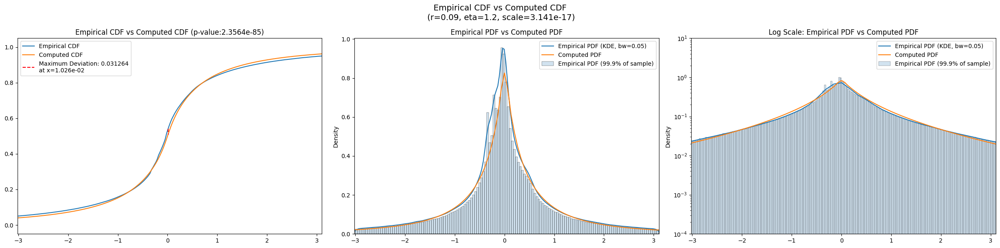

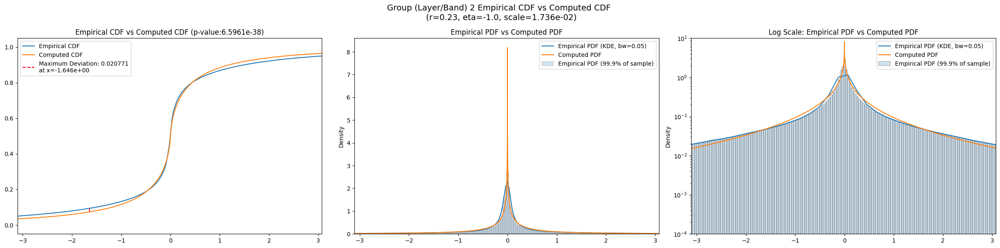

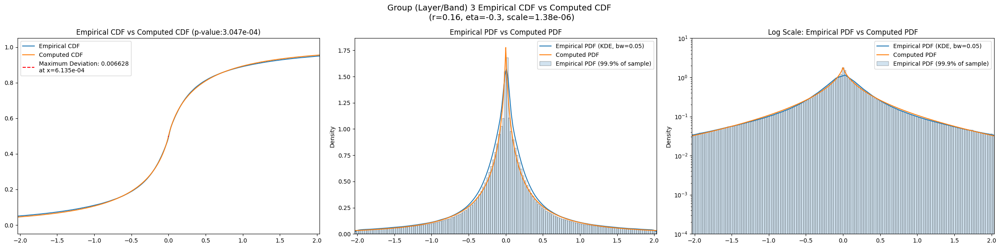

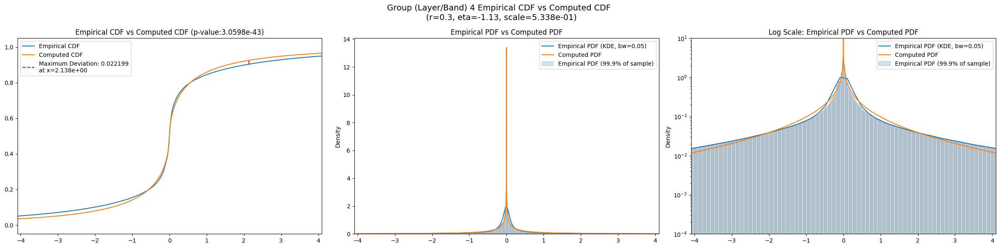

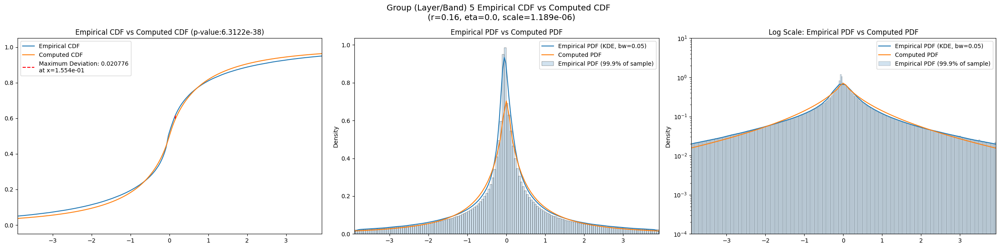

...

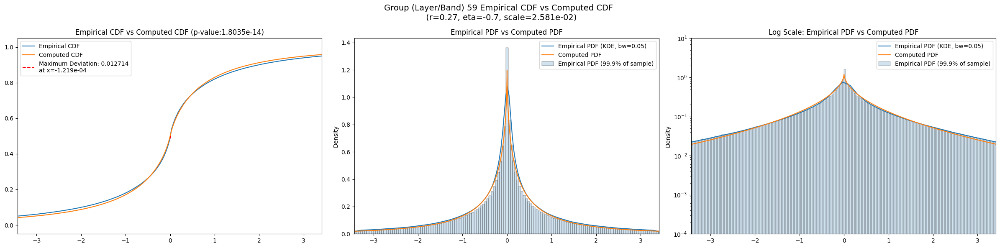

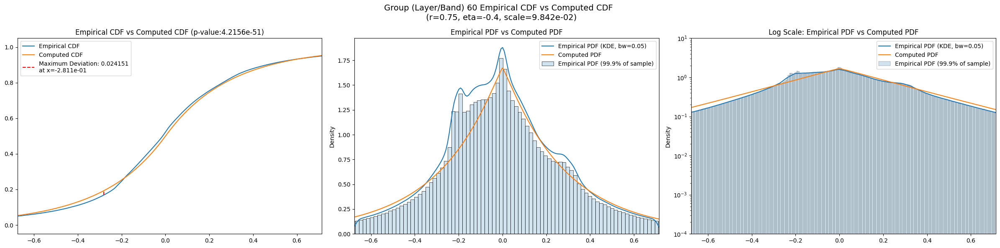

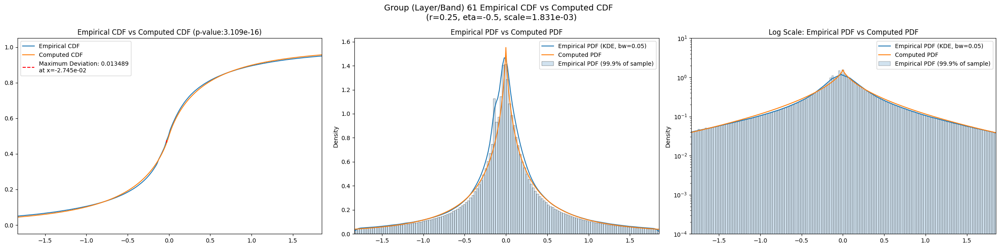

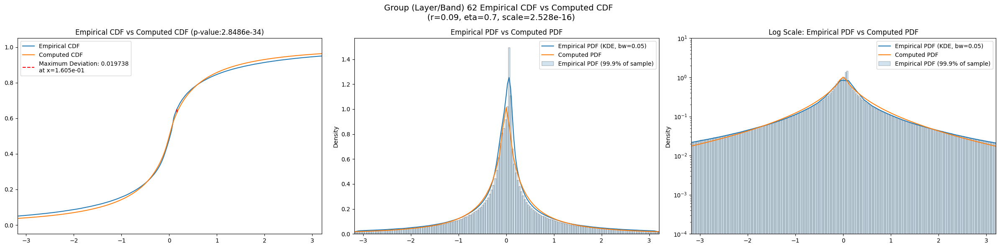

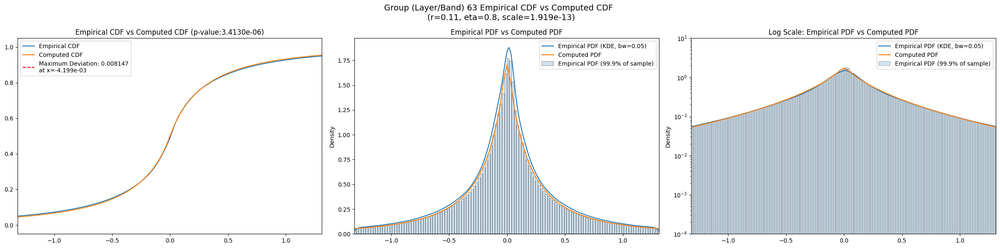

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,4.918292,3.402765,6.778471,14.087733,7.160851,34.707175,7077888.0,dual_color,0.031126,0.1,...,0.944050,0.069063,0.0,0.802910,0.045280,0.0,0.618018,0.046828,0.0,0.000000e+00
2,5.834874,3.930150,8.610619,20.367862,9.880760,60.276031,7077888.0,dual_color,0.022405,0.3,...,0.552408,0.103343,0.0,0.475279,0.080100,0.0,0.357741,0.079297,0.0,0.000000e+00
3,2.401070,1.665375,3.542346,21.989695,7.956547,102.828290,7077888.0,single_edge,0.006777,0.2,...,0.620522,0.067929,0.0,0.547998,0.041337,0.0,0.428768,0.039634,0.0,1.834616e-270
4,8.374049,6.064171,10.875553,12.093866,7.784488,19.337828,7077888.0,dual_color,0.022677,0.4,...,0.686535,0.109452,0.0,0.583379,0.086907,0.0,0.438585,0.086499,0.0,0.000000e+00
5,6.427816,4.854648,7.951692,7.636214,4.954015,14.957260,7077888.0,dual_color,0.021053,0.2,...,1.178290,0.074194,0.0,1.016360,0.048130,0.0,0.799509,0.049895,0.0,0.000000e+00
6,2.961975,2.211630,3.853347,10.482830,4.624699,35.951347,7077888.0,single_edge,0.021525,0.2,...,0.811228,0.072027,0.0,0.698255,0.046150,0.0,0.549398,0.048138,0.0,0.000000e+00
7,2.415839,2.004647,2.878406,2.770392,1.080253,8.056585,7077888.0,inside_out,0.020858,4.8,...,1.272480,0.033322,0.0,1.212230,0.024733,0.0,0.985391,0.021864,0.0,0.000000e+00
8,0.113790,0.088581,0.153305,9.237642,2.534635,61.519856,7077888.0,misc,0.018440,0.1,...,0.253467,0.032760,0.0,0.237188,0.024256,0.0,0.196413,0.018898,0.0,0.000000e+00
9,0.869234,0.549242,1.463015,30.971350,8.339682,139.176879,7077888.0,multi_edge,0.004238,0.2,...,0.394131,0.062343,0.0,0.344030,0.036139,0.0,0.269018,0.036746,0.0,4.901933e-26


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.031126,0.00051,0.031126,0.069063,0.045280,0.046828
2,0.022405,0.00051,0.020771,0.103343,0.080100,0.079297
3,0.006777,0.00051,0.006628,0.067929,0.041337,0.039634
4,0.022677,0.00051,0.022199,0.109452,0.086907,0.086499
5,0.021053,0.00051,0.020786,0.074194,0.048130,0.049895
6,0.021525,0.00051,0.021523,0.072027,0.046150,0.048138
7,0.020858,0.00051,0.020847,0.033322,0.024733,0.021864
8,0.018440,0.00051,0.018439,0.032760,0.024256,0.018898
9,0.004238,0.00051,0.002041,0.062343,0.036139,0.036746


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,4.374348,0.031126,0.09,1.20,3.141475e-17,100.0
2,4.782265,0.020771,0.23,-1.00,1.735770e-02,150.0
3,2.401070,0.006628,0.16,-0.30,1.379921e-06,0.0
4,7.488520,0.022199,0.30,-1.13,5.337540e-01,125.0
5,6.162587,0.020786,0.16,0.00,1.189498e-06,50.0
6,2.729074,0.021523,0.20,-0.31,9.321812e-05,75.0
7,2.249912,0.020847,5.00,-0.52,4.708372e+00,150.0
8,0.098559,0.018439,0.10,9.20,3.329568e-22,175.0
9,0.869234,0.002041,0.20,-0.47,5.147181e-05,0.0
